<a href="https://colab.research.google.com/github/1eetnals/Child-abuse-detection-system-using-TEN4FACESp/blob/main/TEN4_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### installing the required files & import library

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install torch
!pip install torchvision

In [ ]:
!pip install sk-video

In [ ]:
# get the face alignment source code
!git clone https://github.com/1adrianb/face-alignment

fatal: destination path 'face-alignment' already exists and is not an empty directory.


In [ ]:
# install the face alignment lib
!pip install -r "/content/face-alignment/requirements.txt"
!pip install "/content/face-alignment/setup.py"

ERROR: Invalid requirement: '/content/face-alignment/setup.py'
Hint: It looks like a path. The path does exist. 


In [ ]:
# 필요한 library import
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from keras.preprocessing.image import load_img, img_to_array
from matplotlib import animation
from IPython.display import HTML
%matplotlib inline
import fnmatch
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image

import cv2
from google.colab.patches import cv2_imshow

import sys
sys.path.append('/content/face-alignment')

import face_alignment
from mpl_toolkits.mplot3d import Axes3D
from skimage import io
import collections

import skvideo.io

### video to npz file

In [ ]:
video = skvideo.io.vread('/content/drive/Shareddrives/BME캡스톤/code/KYJ/video/kyj.mp4') # 비디오를 읽어옴

print(video.shape) # (frame,y,x,channels)

# 각 프레임 조회
for i, shortcut in enumerate(video):
  print(shortcut.shape,end='/') # example code

(52, 720, 540, 3)
(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/(720, 540, 3)/

### npz file loading
  1. video to npz file 코드 완성 후 수정해야 함

In [ ]:
# csv file 할당
manifest = pd.read_csv('/content/drive/Shareddrives/BME캡스톤/data/data_final/age_prediction/video/youtube_faces_with_keypoints_full.csv')

In [ ]:
# 모든 비디오의 파일 이름 가져오기
matches = [] # matches: 각 파일의 경로를 저장해놓은 변수
for root, dirnames, filenames in os.walk('/content/drive/Shareddrives/BME캡스톤/data/data_final/age_prediction/video'):
    for filename in fnmatch.filter(filenames, '*.npz'):
        matches.append(os.path.join(root, filename))

# 총 2194개의 파일 name을 가져옴
matches = pd.DataFrame(matches)
matches.columns = ['file_name']

# 파일명과 경로 일치시켜 위의 두가지 column을 가진 data frame 만들기
matches = pd.DataFrame([(i,j) for i in manifest.videoID for j in matches.file_name  if i in j])
matches.columns = ['videoID','file_name']

# 새롭게 만든 2개의 columns와 기존의 data frame 합치기
manifest = pd.merge(matches,manifest)

In [ ]:
# 원하는 npz format의 파일 1개 불러오기
with np.load('/content/drive/Shareddrives/BME캡스톤/data/data_final/age_prediction/video/youtube_faces_with_keypoints_full_4/youtube_faces_with_keypoints_full_4/Priscilla_Presley_3.npz') as data:
    colorImages = data['colorImages']
    boundingBox = data['boundingBox']
    landmarks2D = data['landmarks2D']
    landmarks3D = data['landmarks3D']

### Age: 0-6 detection -> capture

### face_alignment model: EYE, EAR, NECK, CHEEK segmentation
  1. 캡쳐된 이미지 불러오는 코드 작성 필요
  2. 예측이 잘 되지 않는 경우 어떻게 할 것인지 논의 필요
    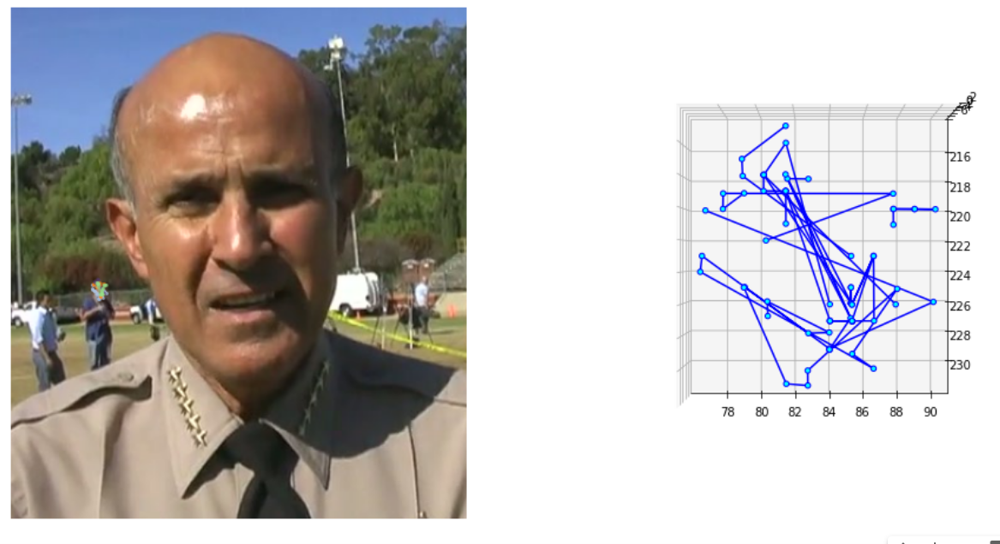

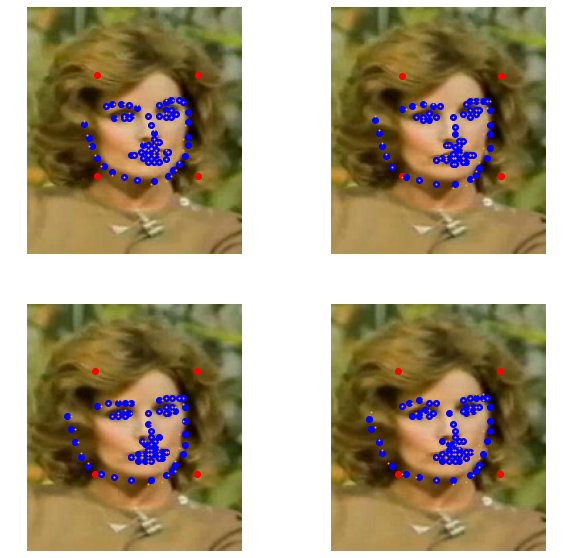

In [ ]:
# npz format의 데이터(landmark||boundingBox)를 읽어와 확인
# 원하는 npz format의 파일 불러오기

with np.load('/content/drive/Shareddrives/BME캡스톤/data/data_final/age_prediction/video/youtube_faces_with_keypoints_full_4/youtube_faces_with_keypoints_full_4/Priscilla_Presley_3.npz') as data:
    colorImages = data['colorImages']
    boundingBox = data['boundingBox']
    landmarks2D = data['landmarks2D']
    landmarks3D = data['landmarks3D']

# 캡쳐된 이미지 불러오는 코드 필요
#colorImages = np.load('jpg_path')

plt.rcParams["figure.figsize"] = (10,10)

fig, _ = plt.subplots(1,1)
plt.axis('off')

ax = []

ax.append(fig.add_subplot(2,2,1))
plt.imshow(colorImages[:,:,:,10])
plt.axis('off')
plt.scatter(pd.DataFrame(boundingBox[:,:,10]).iloc[:,0],pd.DataFrame(boundingBox[:,:,10]).iloc[:,1],color='red')
plt.scatter(pd.DataFrame(landmarks2D[:,:,10]).iloc[:,0],pd.DataFrame(landmarks2D[:,:,10]).iloc[:,1],color='blue')
plt.scatter(pd.DataFrame(landmarks3D[:,:,10]).iloc[:,0],pd.DataFrame(landmarks3D[:,:,10]).iloc[:,1],color='orange',s=1)

ax.append(fig.add_subplot(2,2,2))
plt.imshow(colorImages[:,:,:,20])
plt.axis('off')
plt.scatter(pd.DataFrame(boundingBox[:,:,20]).iloc[:,0],pd.DataFrame(boundingBox[:,:,20]).iloc[:,1],color='red')
plt.scatter(pd.DataFrame(landmarks2D[:,:,20]).iloc[:,0],pd.DataFrame(landmarks2D[:,:,20]).iloc[:,1],color='blue')
plt.scatter(pd.DataFrame(landmarks3D[:,:,20]).iloc[:,0],pd.DataFrame(landmarks3D[:,:,20]).iloc[:,1],color='orange',s=1)

ax.append(fig.add_subplot(2,2,3))
plt.imshow(colorImages[:,:,:,30])
plt.axis('off')
plt.scatter(pd.DataFrame(boundingBox[:,:,30]).iloc[:,0],pd.DataFrame(boundingBox[:,:,30]).iloc[:,1],color='red')
plt.scatter(pd.DataFrame(landmarks2D[:,:,30]).iloc[:,0],pd.DataFrame(landmarks2D[:,:,30]).iloc[:,1],color='blue')
plt.scatter(pd.DataFrame(landmarks3D[:,:,30]).iloc[:,0],pd.DataFrame(landmarks3D[:,:,30]).iloc[:,1],color='orange',s=1)

ax.append(fig.add_subplot(2,2,4))
plt.imshow(colorImages[:,:,:,40])
plt.axis('off')
plt.scatter(pd.DataFrame(boundingBox[:,:,40]).iloc[:,0],pd.DataFrame(boundingBox[:,:,40]).iloc[:,1],color='red')
plt.scatter(pd.DataFrame(landmarks2D[:,:,40]).iloc[:,0],pd.DataFrame(landmarks2D[:,:,40]).iloc[:,1],color='blue')
plt.scatter(pd.DataFrame(landmarks3D[:,:,40]).iloc[:,0],pd.DataFrame(landmarks3D[:,:,40]).iloc[:,1],color='orange',s=1)


(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280

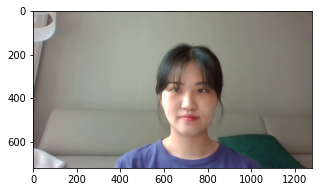

In [ ]:
plt.rcParams["figure.figsize"] = (5,5)

# 영상 출력
def plot_images(img_list):
  def init():
    img.set_data(img_list[0])
    return (img,)

  def animate(i):
    img.set_data(img_list[i])
    return (img,)

  fig = plt.figure()
  ax = fig.gca()
  img = ax.imshow(img_list[0])
  anim = animation.FuncAnimation(fig, animate, init_func=init,
                                 frames=len(img_list), interval=25, blit=True, repeat=False)
  return anim

# 직접 찍은 동영상 업로드시
imgs=[]
for i in range(video.shape[0]):
  imgs.append(video[i,:,:,:])

HTML(plot_images(imgs).to_html5_video())

# 수집한 데이터 활용시
#imgs=[]
#for i in range(colorImages.shape[3]):
#  imgs.append(colorImages[:,:,:,i])
#
#HTML(plot_images(imgs).to_html5_video())


In [ ]:
plt.rcParams["figure.figsize"] = (10,10)

In [ ]:
# Optionally set detector and some additional detector parameters
# 3D landmark 이용
face_detector = 'sfd'
face_detector_kwargs = {
    "filter_threshold" : 0.8
}

# Run the 3D face alignment on a test image, without CUDA.
fa = face_alignment.FaceAlignment(face_alignment.LandmarksType._3D, device='cpu', flip_input=True,
                                  face_detector=face_detector, face_detector_kwargs=face_detector_kwargs)

#input_img = video[video.shape[0]//2,:,:,:] # video -> numpy
#input_img = video[0,:,:,:] # video -> numpy
input_img = colorImages[:,:,:,colorImages[3]//2]

preds = fa.get_landmarks(input_img)[-1]

# 2D-Plot
plot_style = dict(marker='o',
                  markersize=2,
                  linestyle='-',
                  lw=2)

pred_type = collections.namedtuple('prediction_type', ['slice', 'color'])
pred_types = {'face': pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5)),
              'eyebrow1': pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4)),
              'eyebrow2': pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4)),
              'nose': pred_type(slice(27, 31), (0.345, 0.239, 0.443, 0.4)),
              'nostril': pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4)),
              'eye1': pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3)),
              'eye2': pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3)),
              'lips': pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3)),
              'teeth': pred_type(slice(60, 68), (0.596, 0.875, 0.541, 0.4))
              }

fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input_img)

for pred_type in pred_types.values():
    ax.plot(preds[pred_type.slice, 0],
            preds[pred_type.slice, 1],
            color=pred_type.color, **plot_style)

ax.axis('off')

# 3D-Plot
ax = fig.add_subplot(1, 2, 2, projection='3d')
surf = ax.scatter(preds[:, 0] * 1.2,
                  preds[:, 1],
                  preds[:, 2],
                  c='cyan',
                  alpha=1.0,
                  edgecolor='b')

for pred_type in pred_types.values():
    ax.plot3D(preds[pred_type.slice, 0] * 1.2,
              preds[pred_type.slice, 1],
              preds[pred_type.slice, 2], color='blue')

ax.view_init(elev=90., azim=90.)
ax.set_xlim(ax.get_xlim()[::-1])
plt.show()

face_points[pred_type.slice, 0] [ 38.  40.  44.  47.  52.  59.  67.  76.  89. 101. 106. 110. 114. 117.
 118. 120. 120.]
face_points[pred_type.slice, 1] [ 83.  93. 103. 112. 121. 129. 133. 136. 137. 133. 128. 124. 116. 107.
  97.  88.  78.]

face_points[pred_type.slice, 0] [49. 56. 63. 69. 75.]
face_points[pred_type.slice, 1] [78. 75. 74. 75. 76.]

face_points[pred_type.slice, 0] [ 94. 100. 105. 110. 114.]
face_points[pred_type.slice, 1] [74. 71. 70. 70. 70.]

face_points[pred_type.slice, 0] [87. 87. 89. 89.]
face_points[pred_type.slice, 1] [ 83.  91.  97. 103.]

face_points[pred_type.slice, 0] [81. 85. 89. 92. 94.]
face_points[pred_type.slice, 1] [105. 105. 107. 105. 103.]

face_points[pred_type.slice, 0] [59. 64. 68. 73. 69. 64.]
face_points[pred_type.slice, 1] [84. 83. 81. 83. 85. 85.]

face_points[pred_type.slice, 0] [ 94. 100. 105. 108. 105. 100.]
face_points[pred_type.slice, 1] [81. 78. 78. 79. 81. 81.]

face_points[pred_type.slice, 0] [ 75.  80.  87.  89.  93.  98. 102.  98.  94.

(-0.5, 162.5, 187.5, -0.5)

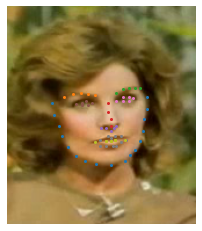

In [ ]:
# 2D 이미지에서 crop
face_detector = 'sfd'
face_detector_kwargs = {
    "filter_threshold" : 0.8
}

# Run the 3D face alignment on a test image, without CUDA.
fa = face_alignment.FaceAlignment(face_alignment.LandmarksType._2D, device='cuda', flip_input=True,
                                  face_detector=face_detector, face_detector_kwargs=face_detector_kwargs)

#input_img = video[video.shape[0]//2,:,:,:] # video -> numpy
#input_img = video[0,:,:,:] # video -> numpy
input_img = colorImages[:,:,:,colorImages.shape[3]//2]

face_points = fa.get_landmarks(input_img)[-1]

# 2D-Plot
plot_style = dict(marker='o',
                  markersize=2,
                  linestyle='',
                  alpha=1.0,)

pred_type = collections.namedtuple('prediction_type', ['slice', 'color'])

# 전체 prediction
pred_types = {'face': pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5)),
              'eyebrow1': pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4)),
              'eyebrow2': pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4)),
              'nose': pred_type(slice(27, 31), (0.345, 0.239, 0.443, 0.4)),
              'nostril': pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4)),
              'eye1': pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3)), #_5
              'eye2': pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3)), #_6
              'lips': pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3)),
              'teeth': pred_type(slice(60, 68), (0.596, 0.875, 0.541, 0.4))
              }

# 필요한 항목만 가져오기
pred_types_essential = {
              'eyebrow1': pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4)),
              'eyebrow2': pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4)),
              'eye1': pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3)), 
              'eye2': pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3)), 
              'face': pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5)),
              'lips': pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3)),
              'nostril': pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4))
              }


fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input_img)

i=1
for pred_type in pred_types.values():
  print('face_points[pred_type.slice, 0]',face_points[pred_type.slice, 0])
  print('face_points[pred_type.slice, 1]',face_points[pred_type.slice, 1])
  print()

  ax.plot(face_points[pred_type.slice, 0],  
          face_points[pred_type.slice, 1],
          **plot_style)
  i+=1
ax.axis('off')



face_points[pred_type.slice, 0] [49. 56. 63. 69. 75.]
face_points[pred_type.slice, 1] [78. 75. 74. 75. 76.]

face_points[pred_type.slice, 0] [ 94. 100. 105. 110. 114.]
face_points[pred_type.slice, 1] [74. 71. 70. 70. 70.]

face_points[pred_type.slice, 0] [59. 64. 68. 73. 69. 64.]
face_points[pred_type.slice, 1] [84. 83. 81. 83. 85. 85.]

face_points[pred_type.slice, 0] [ 94. 100. 105. 108. 105. 100.]
face_points[pred_type.slice, 1] [81. 78. 78. 79. 81. 81.]

face_points[pred_type.slice, 0] [ 38.  40.  44.  47.  52.  59.  67.  76.  89. 101. 106. 110. 114. 117.
 118. 120. 120.]
face_points[pred_type.slice, 1] [ 83.  93. 103. 112. 121. 129. 133. 136. 137. 133. 128. 124. 116. 107.
  97.  88.  78.]

face_points[pred_type.slice, 0] [ 75.  80.  87.  89.  93.  98. 102.  98.  94.  91.  85.  80.]
face_points[pred_type.slice, 1] [117. 115. 112. 113. 112. 112. 115. 117. 120. 120. 120. 120.]

face_points[pred_type.slice, 0] [81. 85. 89. 92. 94.]
face_points[pred_type.slice, 1] [105. 105. 107. 105. 

(-0.5, 162.5, 187.5, -0.5)

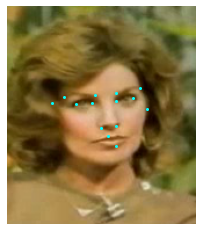

In [ ]:
# 2D 이미지에서 crop: 가장 좌,우측에 위치한 landmark 확인용
face_detector = 'sfd'
face_detector_kwargs = {
    "filter_threshold" : 0.8
}

# Run the 3D face alignment on a test image, without CUDA.
fa = face_alignment.FaceAlignment(face_alignment.LandmarksType._2D, device='cuda', flip_input=True,
                                  face_detector=face_detector, face_detector_kwargs=face_detector_kwargs)

#input_img = video[video.shape[0]//2,:,:,:] # video -> numpy
#input_img = video[0,:,:,:] # video -> numpy
input_img = colorImages[:,:,:,colorImages.shape[3]//2]
face_points = fa.get_landmarks(input_img)[-1]

# 2D-Plot
plot_style = dict(marker='o',
                  markersize=2,
                  linestyle='',
                  alpha=1.0,)

pred_type = collections.namedtuple('prediction_type', ['slice', 'color'])

# 전체 prediction
pred_types = {'face': pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5)),
              'eyebrow1': pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4)),
              'eyebrow2': pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4)),
              'nose': pred_type(slice(27, 31), (0.345, 0.239, 0.443, 0.4)),
              'nostril': pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4)),
              'eye1': pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3)), 
              'eye2': pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3)),
              'lips': pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3)),
              'teeth': pred_type(slice(60, 68), (0.596, 0.875, 0.541, 0.4))
              }

# 필요한 항목만 가져오기
pred_types_essential = {
              'eyebrow1': pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4)),
              'eyebrow2': pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4)),
              'eye1': pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3)), 
              'eye2': pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3)),
              'face': pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5)),
              'lips': pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3)),
              'nostril': pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4))
              }


fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input_img)

i=0
for pred_type in pred_types_essential.values():
  i+=1
  print('face_points[pred_type.slice, 0]',face_points[pred_type.slice, 0])
  print('face_points[pred_type.slice, 1]',face_points[pred_type.slice, 1])
  print()

  arr_x = face_points[pred_type.slice, 0]
  arr_y = face_points[pred_type.slice, 1]

  if i==6:
    max = np.argmax(arr_y)
    min = np.argmin(arr_y)
  else:
    max = np.argmax(arr_x)
    min = np.argmin(arr_x)

  ax.plot(arr_x[max],  
          arr_y[max],
          color='cyan', **plot_style)
  
  ax.plot(arr_x[min],  
          arr_y[min],
          color='cyan', **plot_style)
ax.axis('off')

### 필요한 코드를 함수로 만들어 하나로 합침. 아직은 다양한 케이스 확인을 통해 수정 필요

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)

In [ ]:
# 2D landmark를 이용해 crop:필요한 점을 list에 저장 위치 파악
# 이 코드부터 돌리면 됨

face_detector = 'sfd'
face_detector_kwargs = {
    "filter_threshold" : 0.8
}

fa = face_alignment.FaceAlignment(face_alignment.LandmarksType._2D, device='cuda', flip_input=True,
                                  face_detector=face_detector, face_detector_kwargs=face_detector_kwargs)

# 직접 찍은 영상 업로드시
#input_img = video[video.shape[0]//2,:,:,:] # video -> numpy
#input_img = video[0,:,:,:] # video -> numpy

# 수집한 데이터 활용시
#input_img = colorImages[:,:,:,colorImages.shape[3]//2]

######################################################################################################################################### np2list
def file2frame(input_img):
  face_points = fa.get_landmarks(input_img)[-1]

  # 2D-Plot
  plot_style = dict(marker='o',
                    markersize=2,
                    linestyle='',
                    alpha=1.0,)

  pred_type = collections.namedtuple('prediction_type', ['slice', 'color'])

  fig = plt.figure(figsize=plt.figaspect(.5))
  ax = fig.add_subplot(1, 2, 1)
  ax.imshow(input_img)

  list_x = []
  list_y = []
  ################################################################################ EYE
  # left_EYE
  eye1 = pred_type(slice(36, 42), (0.596, 0.875, 0.541, 0.3))
  arr_x = face_points[eye1.slice, 0]
  arr_y = face_points[eye1.slice, 1]

  left_min_x = np.argmin(arr_x) # 가장 좌측점의 arry index 구하기
  list_x.append(arr_x[left_min_x])
  list_y.append(arr_y[left_min_x])

  # right_EYE
  eye2 = pred_type(slice(42, 48), (0.596, 0.875, 0.541, 0.3))
  arr_x = face_points[eye2.slice, 0]
  arr_y = face_points[eye2.slice, 1]

  right_max_x = np.argmax(arr_x) # 가장 우측점의 arry index 구하기
  list_x.append(arr_x[right_max_x])
  list_y.append(arr_y[right_max_x])

  # left_EYEBROW
  eyebrow1 = pred_type(slice(17, 22), (1.0, 0.498, 0.055, 0.4))
  arr_x = face_points[eyebrow1.slice, 0]
  arr_y = face_points[eyebrow1.slice, 1]

  left_min_x = np.argmin(arr_x) # 가장 좌측점의 arry index 구하기
  list_x.append(arr_x[left_min_x])
  list_y.append(arr_y[left_min_x])

  # right_EYEBROW
  eyebrow2 = pred_type(slice(22, 27), (1.0, 0.498, 0.055, 0.4))
  arr_x = face_points[eyebrow2.slice, 0]
  arr_y = face_points[eyebrow2.slice, 1]

  right_max_x = np.argmax(arr_x) # 가장 우측점의 arry index 구하기
  list_x.append(arr_x[right_max_x])
  list_y.append(arr_y[right_max_x])

  ################################################################################ EAR
  # left_EAR
  ear = pred_type(slice(0, 17), (0.682, 0.780, 0.909, 0.5))
  arr_x = face_points[ear.slice, 0]
  arr_y = face_points[ear.slice, 1]

  left_min_x = np.argmin(arr_x) # 가장 좌측점의 arry index 구하기
  list_x.append(arr_x[left_min_x])
  list_y.append(arr_y[left_min_x])

  # right_EAR
  arr_x = face_points[ear.slice, 0]
  arr_y = face_points[ear.slice, 1]

  right_max_x = np.argmax(arr_x) # 가장 우측점의 arry index 구하기
  list_x.append(arr_x[right_max_x])
  list_y.append(arr_y[right_max_x])

  # lip_high
  lip = pred_type(slice(48, 60), (0.596, 0.875, 0.541, 0.3))
  arr_x = face_points[lip.slice, 0]
  arr_y = face_points[lip.slice, 1]

  max = np.argmin(arr_y) # 가장 높은점의 arry index 구하기
  list_x.append(arr_x[max])
  list_y.append(arr_y[max])

  ################################################################################ NECK
  # lip_low
  max = np.argmax(arr_y) # 가장 낮은점의 arry index 구하기
  list_x.append(arr_x[max])
  list_y.append(arr_y[max])

  ################################################################################ CHEEK
  # nostrill_left
  nostrill = pred_type(slice(31, 36), (0.345, 0.239, 0.443, 0.4))
  arr_x = face_points[nostrill.slice, 0]
  arr_y = face_points[nostrill.slice, 1]

  left_min_x = np.argmin(arr_x) # 가장 좌측점의 arry index 구하기
  list_x.append(arr_x[left_min_x])
  list_y.append(arr_y[left_min_x])

  # nostrill_right
  right_max_x = np.argmax(arr_x) # 가장 우측점의 arry index 구하기
  list_x.append(arr_x[right_max_x])
  list_y.append(arr_y[right_max_x])

  ################################################################################ 사용할 좌표 값 담은 list 생성 -> array로 변경
  # list to arr
  # x(좌표) = [eye1_left, eye2_right, eyebrow1_left, eyebrow2_right, ear1_left, ear2_right, lip_high, lip_low, nostrill_left, nostrill_right]
  # y(좌표) = [eye1_left, eye2_right, eyebrow1_left, eyebrow2_right, ear1_left, ear2_right, lip_high, lip_low, nostrill_left, nostrill_right]
  x = np.array(list_x)
  y = np.array(list_y)

  return x,y
  #print(f'x = {x}')
  #print(f'y = {y}')

  # 위치 확인
  #ax.plot(x, y, color='cyan', **plot_style)
  #ax.axis('off')
######################################################################################################################################### CROP function

def im_trim (img,x,y,idx):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)     # 이미지 색상 변환: openCV는 기본적으로 bgr로 구성

  # EYE
  x_extra_eye = (x[1]-x[0])//3                   # 양안 전체 길이의 1/3정도 여유를 두고 crop 
  
  if y[2]-y[0] < y[3]-y[1]:                      # 눈썹 양 끝 점을 기준으로 눈과의 간격이 더 긴 점을 찾고, 그 높이*1.5 만큼 crop
    y_diff_eye = (y[3]-y[1])//1.5
  else:
    y_diff_eye = (y[2]-y[0])//1.5
  
  if y[0] < y[1]:                                # 양안 중 높이가 더 낮은 것을 기준으로 y의 범위를 지정해줌
    y_start_eye = int(y[0]+y_diff_eye)
    y_end_eye = int(y[1]-y_diff_eye)
  else:
    y_start_eye = int(y[1]+y_diff_eye)
    y_end_eye = int(y[0]-y_diff_eye)
  
  # EAR
  '''
  if x[1]-x[4] > x[5]-x[3]:
    x_extra_ear = (x[1]-x[4])//3
  else:
    x_extra_ear = (x[5]-x[3])//3
  '''
  y_start_ear = int(y[3]+y_diff_eye)
  y_end_ear = int(y[6]-y_diff_eye)
  
  # NECK
  y_start_neck = int(y[7])

  # CHEEK: 기존에 연산해놓은 좌표 활용  

  # crop
  # ear, cheek는 x의 범위가 40이하일 경우 무시해줌
  
  ############################################################################## CHEEK & EAR
  if int(x[8]-x[4]) >= int(x[5]-x[9]):                                         # 양 볼의 x좌표 차이 중 그 차이가 큰 것을 cheek_diff에 저장
    cheek_diff = int(x[8]-x[4])                                                # max() 사용시 python 'numpy.int64' object is not callable error 발생 
  else:
    cheek_diff = int(x[5]-x[9])
  cheek_js = cheek_diff//2                                                     # cheek_diff//3 보다 그 넓이가 작을 경우: 측면에 해당하므로 cheek & ear 출력 및 저장 X
  if int(x[8])-int(x[4])>cheek_js:                                             
    img_trim_cheek_left = img[y_end_eye:int(y[7]), int(x[4]):int(x[8])]                               # cheek_left    
    print(f'\033[1mleft cheek shape\033[0m: {img_trim_cheek_left.shape}')
    print(f'y범위: {int(y_end_eye)}~{int(y[7])}')
    print(f'x범위: {int(x[4])}~{int(x[8])}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_cheek_left_{idx}.jpg',img_trim_cheek_left)
    cv2.rectangle(img, (int(x[4]), int(y_end_eye)), (int(x[8]),int(y[7])), (0,255,255), 1)               

    img_trim_ear_left = img[y_start_ear:y_end_ear, int(x[4]-cheek_js):int(x[4]-y_diff_eye)]         # ear_left         
    print(f'\033[1mleft ear shape\033[0m: {img_trim_ear_left.shape}')
    print(f'y범위: {int(y_start_ear)}~{int(y_end_ear)}')
    print(f'x범위: {int(x[4]-cheek_js)}~{int(x[4]-y_diff_eye)}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_ear_left_{idx}.jpg',img_trim_ear_left)
    cv2.rectangle(img, (int(x[4]-cheek_js), int(y_start_ear)), (int(x[4]-y_diff_eye),int(y_end_ear)), (255,0,0), 1)             

  if int(x[5])-int(x[9])>cheek_js:                                              
    img_trim_cheek_right = img[y_end_eye:int(y[7]), int(x[9]):int(x[5])]                               # cheek_right                           
    print(f'\033[1mright cheek shape\033[0m: {img_trim_cheek_right.shape}')
    print(f'y범위: {int(y_end_eye)}~{int(y[7])}')
    print(f'x범위: {int(x[9])}~{int(x[5])}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_cheek_right_{idx}.jpg',img_trim_cheek_right)
    cv2.rectangle(img, (int(x[9]), int(y_end_eye)), (int(x[5]),int(y[7])), (0,255,255), 1)                                        
    
    img_trim_ear_right = img[y_start_ear:y_end_ear, int(x[5]+y_diff_eye):int(x[5]+cheek_js)]         # ear_right
    print(f'\033[1mright ear shape\033[0m: {img_trim_ear_right.shape}')
    print(f'y범위: {int(y_start_ear)}~{int(y_end_ear)}')
    print(f'x범위: {int(x[5]+y_diff_eye)}~{int(x[5]+cheek_js)}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_ear_right_{idx}.jpg',img_trim_ear_right)
    cv2.rectangle(img, (int(x[5]+y_diff_eye), int(y_start_ear)), (int(x[5]+cheek_js),int(y_end_ear)), (255,0,0), 1)             

  ############################################################################## EYE
  img_trim_eye = img[y_start_eye:y_end_eye, int(x[0]-x_extra_eye):int(x[1]+x_extra_eye)]              
  
  ############################################################################## NECK
  img_trim_neck = img[y_start_neck:img.shape[0], int(x[4]-cheek_js//2):int(x[5]+cheek_js//2)]                                   # neck: neck_end를 귀의 x_end에 맞추자


  print(f'\033[1meye shape\033[0m: {img_trim_eye.shape}')
  print(f'y범위: {int(y_start_eye)}~{int(y_end_eye)}')
  print(f'x범위: {int(x[0]-x_extra_eye)}~{int(x[1]+x_extra_eye)}')

  print(f'\033[1mneck shape\033[0m: {img_trim_neck.shape}') 
  print(f'y범위: {int(y_end_eye)}~{y_start_neck}')
  print(f'x범위: {int(x[4]-cheek_js//2)}~{int(x[5]+cheek_js//2)}')
  
  #img_trim = cv2.resize(img_trim, dsize=(100,100)) # resize하면 해상도가 너무 떨어져서 논의 필요
  cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_eye_{idx}.jpg',img_trim_eye)   # eye의 y 수정할 필요있음 (수집된 이미지는 y의 방향이 역방향으로 나옴)
  cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_neck_{idx}.jpg',img_trim_neck) 

  # crop될 이미지: bounding box 표시
  cv2.rectangle(img, (int(x[0]-x_extra_eye), int(y_start_eye)), (int(x[1]+x_extra_eye),int(y_end_eye)), (0,0,255), 1)            # eye
  cv2.rectangle(img, (int(x[4]-cheek_js//2), int(y_start_neck)), (int(x[5]+cheek_js//2),int(img.shape[0])), (255,0,255), 1)                              # neck

  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

  return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# 영상 출력
def plot_images(img_list):
  def init():
    img.set_data(img_list[0])
    return (img,)

  def animate(i):
    img.set_data(img_list[i])
    return (img,)

  fig = plt.figure()
  ax = fig.gca()
  img = ax.imshow(img_list[0])
  anim = animation.FuncAnimation(fig, animate, init_func=init,
                                 frames=len(img_list), interval=45, blit=True, repeat=False)
  return anim

left cheek shape: (95, 68, 3)
y범위: 388~483
x범위: 166~234
left ear shape: (136, 58, 3)
y범위: 336~472
x범위: 123~181
right cheek shape: (95, 87, 3)
y범위: 388~483
x범위: 262~349
right ear shape: (136, 58, 3)
y범위: 336~472
x범위: 334~392
eye shape: (33, 182, 3)
y범위: 355~388
x범위: 162~344
neck shape: (237, 225, 3)
y범위: 388~483
x범위: 145~370


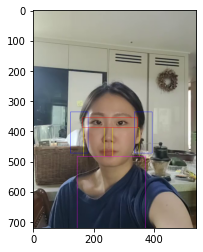

left cheek shape: (94, 67, 3)
y범위: 389~483
x범위: 169~236
left ear shape: (136, 57, 3)
y범위: 336~472
x범위: 127~184
right cheek shape: (94, 84, 3)
y범위: 389~483
x범위: 265~349
right ear shape: (136, 57, 3)
y범위: 336~472
x범위: 334~391
eye shape: (34, 181, 3)
y범위: 355~389
x범위: 162~343
neck shape: (237, 222, 3)
y범위: 389~483
x범위: 148~370


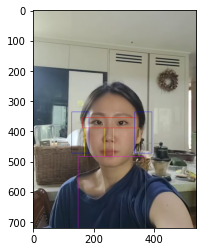

left cheek shape: (109, 70, 3)
y범위: 384~493
x범위: 172~242
left ear shape: (134, 57, 3)
y범위: 336~470
x범위: 129~186
right cheek shape: (109, 86, 3)
y범위: 384~493
x범위: 272~358
right ear shape: (134, 57, 3)
y범위: 336~470
x범위: 344~401
eye shape: (28, 182, 3)
y범위: 356~384
x범위: 169~351
neck shape: (227, 228, 3)
y범위: 384~493
x범위: 151~379


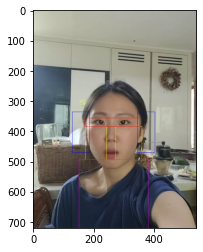

left cheek shape: (109, 70, 3)
y범위: 384~493
x범위: 172~242
left ear shape: (134, 57, 3)
y범위: 336~470
x범위: 129~186
right cheek shape: (109, 86, 3)
y범위: 384~493
x범위: 272~358
right ear shape: (134, 57, 3)
y범위: 336~470
x범위: 344~401
eye shape: (28, 182, 3)
y범위: 356~384
x범위: 169~351
neck shape: (227, 228, 3)
y범위: 384~493
x범위: 151~379


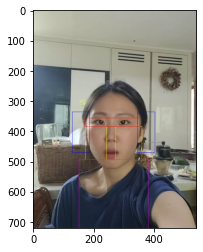

left cheek shape: (108, 69, 3)
y범위: 385~493
x범위: 173~242
left ear shape: (134, 57, 3)
y범위: 337~471
x범위: 130~187
right cheek shape: (108, 86, 3)
y범위: 385~493
x범위: 272~358
right ear shape: (134, 57, 3)
y범위: 337~471
x범위: 344~401
eye shape: (28, 187, 3)
y범위: 357~385
x범위: 165~352
neck shape: (227, 227, 3)
y범위: 385~493
x범위: 152~379


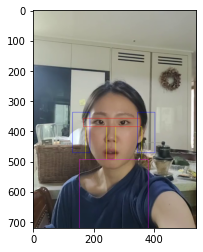

left cheek shape: (103, 69, 3)
y범위: 390~493
x범위: 173~242
left ear shape: (138, 59, 3)
y범위: 335~473
x범위: 130~189
right cheek shape: (103, 86, 3)
y범위: 390~493
x범위: 272~358
right ear shape: (138, 59, 3)
y범위: 335~473
x범위: 342~401
eye shape: (35, 187, 3)
y범위: 355~390
x범위: 165~352
neck shape: (227, 227, 3)
y범위: 390~493
x범위: 152~379


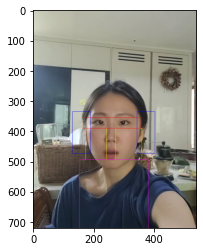

left cheek shape: (99, 70, 3)
y범위: 392~491
x범위: 172~242
left ear shape: (137, 61, 3)
y범위: 337~474
x범위: 127~188
right cheek shape: (99, 90, 3)
y범위: 392~491
x범위: 268~358
right ear shape: (137, 61, 3)
y범위: 337~474
x범위: 342~403
eye shape: (36, 181, 3)
y범위: 356~392
x범위: 166~347
neck shape: (229, 230, 3)
y범위: 392~491
x범위: 150~380


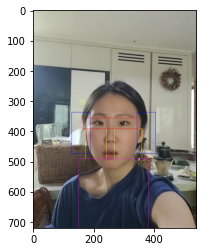

left cheek shape: (100, 66, 3)
y범위: 391~491
x범위: 173~239
left ear shape: (138, 60, 3)
y범위: 336~474
x범위: 129~189
right cheek shape: (100, 89, 3)
y범위: 391~491
x범위: 269~358
right ear shape: (138, 60, 3)
y범위: 336~474
x범위: 342~402
eye shape: (35, 182, 3)
y범위: 356~391
x범위: 166~348
neck shape: (229, 229, 3)
y범위: 391~491
x범위: 151~380


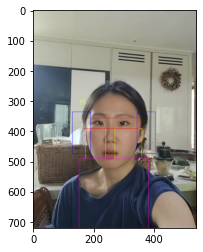

left cheek shape: (99, 65, 3)
y범위: 390~489
x범위: 173~238
left ear shape: (140, 60, 3)
y범위: 335~475
x범위: 129~189
right cheek shape: (99, 88, 3)
y범위: 390~489
x범위: 268~356
right ear shape: (140, 60, 3)
y범위: 335~475
x범위: 340~400
eye shape: (35, 180, 3)
y범위: 355~390
x범위: 166~346
neck shape: (231, 227, 3)
y범위: 390~489
x범위: 151~378


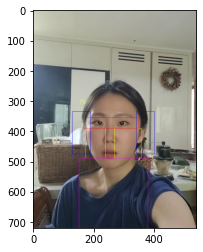

left cheek shape: (96, 62, 3)
y범위: 388~484
x범위: 172~234
left ear shape: (141, 63, 3)
y범위: 333~474
x범위: 125~188
right cheek shape: (96, 95, 3)
y범위: 388~484
x범위: 263~358
right ear shape: (141, 63, 3)
y범위: 333~474
x범위: 342~405
eye shape: (35, 180, 3)
y범위: 353~388
x범위: 165~345
neck shape: (236, 232, 3)
y범위: 388~484
x범위: 149~381


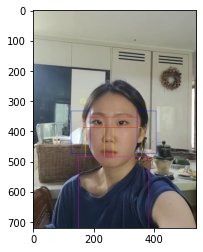

right cheek shape: (94, 106, 3)
y범위: 389~483
x범위: 248~354
right ear shape: (136, 68, 3)
y범위: 337~473
x범위: 339~407
eye shape: (33, 176, 3)
y범위: 356~389
x범위: 155~331
neck shape: (237, 238, 3)
y범위: 389~483
x범위: 142~380


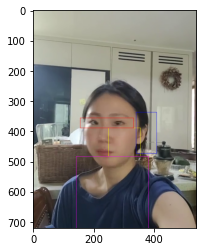

right cheek shape: (96, 112, 3)
y범위: 386~482
x범위: 236~348
right ear shape: (128, 69, 3)
y범위: 341~469
x범위: 335~404
eye shape: (29, 165, 3)
y범위: 357~386
x범위: 152~317
neck shape: (238, 239, 3)
y범위: 386~482
x범위: 137~376


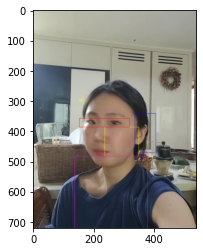

right cheek shape: (87, 125, 3)
y범위: 388~475
x범위: 221~346
right ear shape: (133, 77, 3)
y범위: 335~468
x범위: 331~408
eye shape: (40, 155, 3)
y범위: 348~388
x범위: 149~304
neck shape: (245, 248, 3)
y범위: 388~475
x범위: 129~377


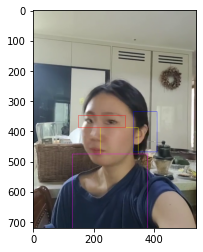

right cheek shape: (85, 131, 3)
y범위: 383~468
x범위: 205~336
right ear shape: (127, 78, 3)
y범위: 335~462
x범위: 323~401
eye shape: (36, 136, 3)
y범위: 347~383
x범위: 147~283
neck shape: (252, 242, 3)
y범위: 383~468
x범위: 126~368


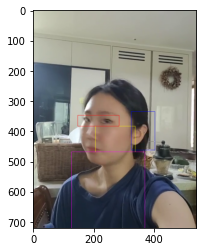

right cheek shape: (85, 132, 3)
y범위: 379~464
x범위: 198~330
right ear shape: (121, 79, 3)
y범위: 334~455
x범위: 317~396
eye shape: (32, 121, 3)
y범위: 347~379
x범위: 148~269
neck shape: (256, 242, 3)
y범위: 379~464
x범위: 121~363


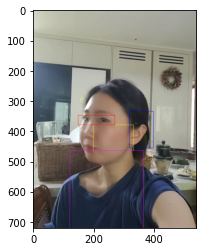

right cheek shape: (83, 132, 3)
y범위: 378~461
x범위: 189~321
right ear shape: (116, 78, 3)
y범위: 336~452
x범위: 309~387
eye shape: (36, 112, 3)
y범위: 342~378
x범위: 145~257
neck shape: (259, 235, 3)
y범위: 378~461
x범위: 119~354


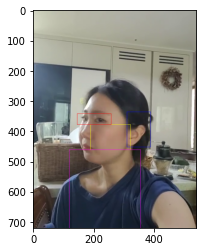

right cheek shape: (82, 130, 3)
y범위: 379~461
x범위: 185~315
right ear shape: (115, 77, 3)
y범위: 337~452
x범위: 303~380
eye shape: (36, 101, 3)
y범위: 343~379
x범위: 147~248
neck shape: (259, 227, 3)
y범위: 379~461
x범위: 120~347


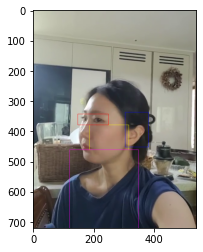

right cheek shape: (84, 130, 3)
y범위: 379~463
x범위: 180~310
right ear shape: (117, 77, 3)
y범위: 337~454
x범위: 298~375
eye shape: (30, 90, 3)
y범위: 349~379
x범위: 147~237
neck shape: (257, 224, 3)
y범위: 379~463
x범위: 118~342


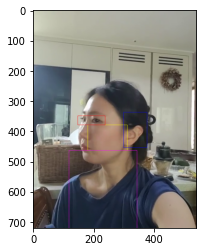

right cheek shape: (82, 128, 3)
y범위: 381~463
x범위: 177~305
right ear shape: (115, 76, 3)
y범위: 339~454
x범위: 293~369
eye shape: (33, 81, 3)
y범위: 348~381
x범위: 149~230
neck shape: (257, 219, 3)
y범위: 381~463
x범위: 118~337


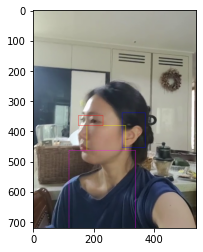

right cheek shape: (79, 126, 3)
y범위: 385~464
x범위: 169~295
right ear shape: (121, 77, 3)
y범위: 336~457
x범위: 281~358
eye shape: (37, 65, 3)
y범위: 348~385
x범위: 150~215
neck shape: (256, 206, 3)
y범위: 385~464
x범위: 120~326


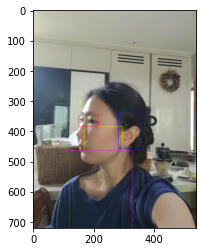

right cheek shape: (83, 123, 3)
y범위: 378~461
x범위: 168~291
right ear shape: (119, 73, 3)
y범위: 336~455
x범위: 279~352
eye shape: (30, 65, 3)
y범위: 348~378
x범위: 149~214
neck shape: (259, 201, 3)
y범위: 378~461
x범위: 120~321


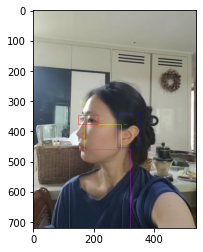

right cheek shape: (84, 124, 3)
y범위: 379~463
x범위: 168~292
right ear shape: (117, 74, 3)
y범위: 337~454
x범위: 280~354
eye shape: (33, 55, 3)
y범위: 346~379
x범위: 154~209
neck shape: (257, 204, 3)
y범위: 379~463
x범위: 119~323


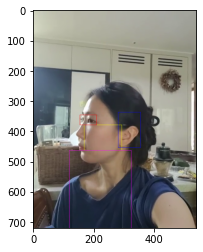

right cheek shape: (83, 125, 3)
y범위: 383~466
x범위: 165~290
right ear shape: (116, 74, 3)
y범위: 341~457
x범위: 278~352
eye shape: (33, 55, 3)
y범위: 350~383
x범위: 154~209
neck shape: (254, 202, 3)
y범위: 383~466
x범위: 119~321


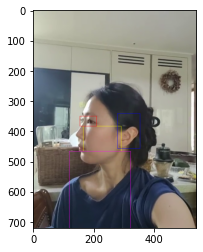

right cheek shape: (84, 126, 3)
y범위: 384~468
x범위: 163~289
right ear shape: (116, 75, 3)
y범위: 343~459
x범위: 277~352
eye shape: (33, 55, 3)
y범위: 351~384
x범위: 152~207
neck shape: (252, 202, 3)
y범위: 384~468
x범위: 118~320


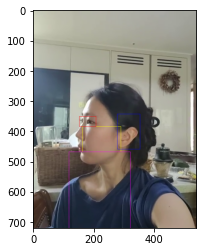

right cheek shape: (83, 124, 3)
y범위: 382~465
x범위: 164~288
right ear shape: (116, 74, 3)
y범위: 340~456
x범위: 276~350
eye shape: (33, 52, 3)
y범위: 349~382
x범위: 154~206
neck shape: (255, 201, 3)
y범위: 382~465
x범위: 118~319


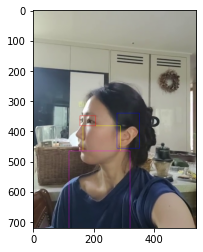

right cheek shape: (87, 122, 3)
y범위: 381~468
x범위: 168~290
right ear shape: (116, 73, 3)
y범위: 340~456
x범위: 278~351
eye shape: (33, 62, 3)
y범위: 348~381
x범위: 150~212
neck shape: (252, 200, 3)
y범위: 381~468
x범위: 120~320


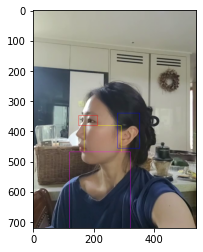

right cheek shape: (87, 123, 3)
y범위: 378~465
x범위: 171~294
right ear shape: (117, 73, 3)
y범위: 336~453
x범위: 282~355
eye shape: (30, 62, 3)
y범위: 348~378
x범위: 153~215
neck shape: (255, 200, 3)
y범위: 378~465
x범위: 124~324


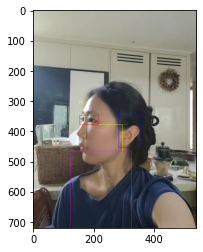

right cheek shape: (88, 126, 3)
y범위: 381~469
x범위: 174~300
right ear shape: (124, 77, 3)
y범위: 332~456
x범위: 286~363
eye shape: (37, 72, 3)
y범위: 344~381
x범위: 151~223
neck shape: (251, 205, 3)
y범위: 381~469
x범위: 126~331


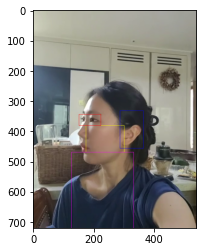

right cheek shape: (94, 127, 3)
y범위: 378~472
x범위: 177~304
right ear shape: (118, 75, 3)
y범위: 336~454
x범위: 292~367
eye shape: (30, 81, 3)
y범위: 348~378
x범위: 148~229
neck shape: (248, 211, 3)
y범위: 378~472
x범위: 124~335


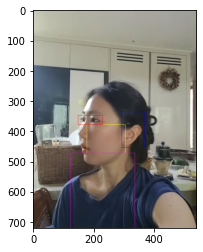

right cheek shape: (94, 129, 3)
y범위: 376~470
x범위: 182~311
right ear shape: (124, 77, 3)
y범위: 331~455
x범위: 298~375
eye shape: (26, 86, 3)
y범위: 350~376
x범위: 150~236
neck shape: (250, 220, 3)
y범위: 376~470
x범위: 123~343


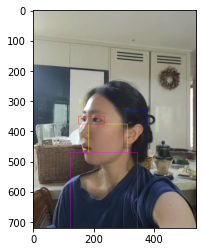

right cheek shape: (93, 131, 3)
y범위: 378~471
x범위: 188~319
right ear shape: (128, 79, 3)
y범위: 329~457
x범위: 305~384
eye shape: (34, 101, 3)
y범위: 344~378
x범위: 147~248
neck shape: (249, 228, 3)
y범위: 378~471
x범위: 123~351


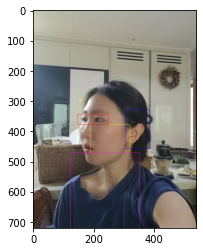

right cheek shape: (97, 126, 3)
y범위: 376~473
x범위: 199~325
right ear shape: (126, 76, 3)
y범위: 331~457
x범위: 312~388
eye shape: (26, 115, 3)
y범위: 350~376
x범위: 148~263
neck shape: (247, 232, 3)
y범위: 376~473
x범위: 124~356


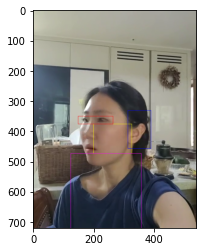

right cheek shape: (92, 124, 3)
y범위: 378~470
x범위: 206~330
right ear shape: (124, 75, 3)
y범위: 330~454
x범위: 317~392
eye shape: (29, 127, 3)
y범위: 349~378
x범위: 149~276
neck shape: (250, 234, 3)
y범위: 378~470
x범위: 127~361


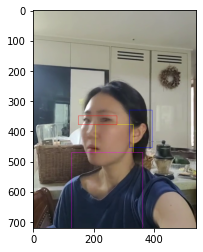

right cheek shape: (93, 122, 3)
y범위: 376~469
x범위: 217~339
right ear shape: (129, 74, 3)
y범위: 327~456
x범위: 326~400
eye shape: (26, 145, 3)
y범위: 350~376
x범위: 150~295
neck shape: (251, 236, 3)
y범위: 376~469
x범위: 133~369


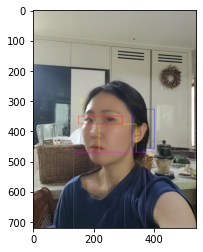

right cheek shape: (92, 119, 3)
y범위: 376~468
x범위: 232~351
right ear shape: (131, 73, 3)
y범위: 328~459
x범위: 337~410
eye shape: (28, 155, 3)
y범위: 348~376
x범위: 156~311
neck shape: (252, 241, 3)
y범위: 376~468
x범위: 139~380


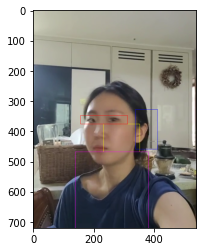

right cheek shape: (91, 110, 3)
y범위: 377~468
x범위: 244~354
right ear shape: (127, 67, 3)
y범위: 331~458
x범위: 342~409
eye shape: (28, 166, 3)
y범위: 349~377
x범위: 158~324
neck shape: (252, 236, 3)
y범위: 377~468
x범위: 145~381


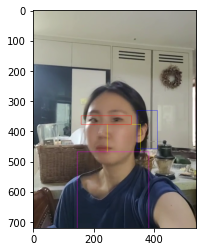

left cheek shape: (92, 55, 3)
y범위: 378~470
x범위: 176~231
left ear shape: (138, 65, 3)
y범위: 323~461
x범위: 127~192
right cheek shape: (92, 99, 3)
y범위: 378~470
x범위: 260~359
right ear shape: (138, 65, 3)
y범위: 323~461
x범위: 343~408
eye shape: (32, 175, 3)
y범위: 346~378
x범위: 164~339
neck shape: (250, 231, 3)
y범위: 378~470
x범위: 152~383


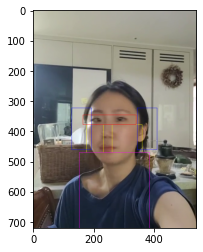

left cheek shape: (89, 66, 3)
y범위: 380~469
x범위: 176~242
left ear shape: (138, 59, 3)
y범위: 324~462
x범위: 132~191
right cheek shape: (89, 89, 3)
y범위: 380~469
x범위: 270~359
right ear shape: (138, 59, 3)
y범위: 324~462
x범위: 344~403
eye shape: (34, 172, 3)
y범위: 346~380
x범위: 173~345
neck shape: (251, 227, 3)
y범위: 380~469
x범위: 154~381


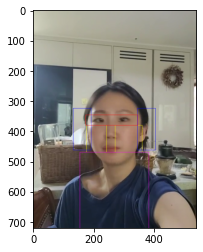

left cheek shape: (92, 73, 3)
y범위: 378~470
x범위: 180~253
left ear shape: (131, 54, 3)
y범위: 330~461
x범위: 139~193
right cheek shape: (92, 82, 3)
y범위: 378~470
x범위: 282~364
right ear shape: (131, 54, 3)
y범위: 330~461
x범위: 351~405
eye shape: (29, 180, 3)
y범위: 349~378
x범위: 179~359
neck shape: (250, 224, 3)
y범위: 378~470
x범위: 160~384


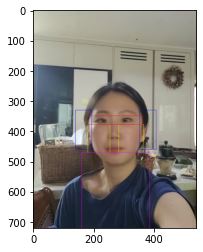

left cheek shape: (89, 83, 3)
y범위: 382~471
x범위: 182~265
left ear shape: (138, 56, 3)
y범위: 326~464
x범위: 141~197
right cheek shape: (89, 73, 3)
y범위: 382~471
x범위: 294~367
right ear shape: (138, 56, 3)
y범위: 326~464
x범위: 352~408
eye shape: (34, 181, 3)
y범위: 348~382
x범위: 184~365
neck shape: (249, 225, 3)
y범위: 382~471
x범위: 162~387


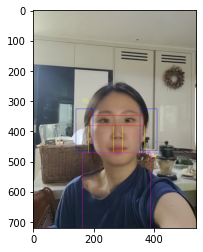

left cheek shape: (95, 85, 3)
y범위: 378~473
x범위: 189~274
left ear shape: (130, 55, 3)
y범위: 330~460
x범위: 147~202
right cheek shape: (95, 67, 3)
y범위: 378~473
x범위: 302~369
right ear shape: (130, 55, 3)
y범위: 330~460
x범위: 356~411
eye shape: (29, 177, 3)
y범위: 349~378
x범위: 195~372
neck shape: (247, 222, 3)
y범위: 378~473
x범위: 168~390


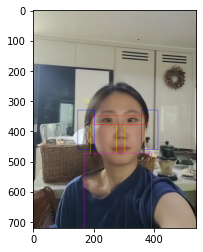

left cheek shape: (92, 96, 3)
y범위: 378~470
x범위: 191~287
left ear shape: (130, 61, 3)
y범위: 330~460
x범위: 143~204
right cheek shape: (92, 57, 3)
y범위: 378~470
x범위: 315~372
right ear shape: (130, 61, 3)
y범위: 330~460
x범위: 359~420
eye shape: (29, 175, 3)
y범위: 349~378
x범위: 207~382
neck shape: (250, 229, 3)
y범위: 378~470
x범위: 167~396


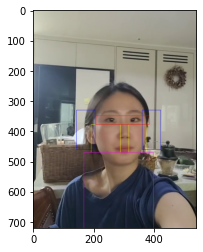

left cheek shape: (92, 101, 3)
y범위: 379~471
x범위: 192~293
left ear shape: (128, 63, 3)
y범위: 331~459
x범위: 142~205
right cheek shape: (92, 54, 3)
y범위: 379~471
x범위: 322~376
right ear shape: (128, 63, 3)
y범위: 331~459
x범위: 363~426
eye shape: (29, 170, 3)
y범위: 350~379
x범위: 215~385
neck shape: (249, 234, 3)
y범위: 379~471
x범위: 167~401


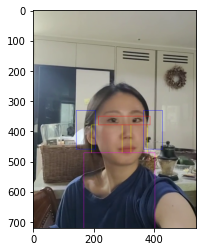

left cheek shape: (89, 108, 3)
y범위: 384~473
x범위: 196~304
left ear shape: (137, 70, 3)
y범위: 326~463
x범위: 142~212
eye shape: (35, 162, 3)
y범위: 349~384
x범위: 225~387
neck shape: (247, 235, 3)
y범위: 384~473
x범위: 169~404


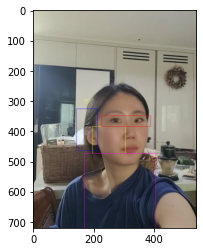

left cheek shape: (91, 112, 3)
y범위: 379~470
x범위: 199~311
left ear shape: (126, 69, 3)
y범위: 331~457
x범위: 143~212
eye shape: (29, 162, 3)
y범위: 350~379
x범위: 232~394
neck shape: (250, 237, 3)
y범위: 379~470
x범위: 171~408


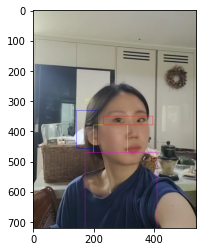

left cheek shape: (90, 125, 3)
y범위: 380~470
x범위: 199~324
left ear shape: (131, 76, 3)
y범위: 328~459
x범위: 137~213
eye shape: (31, 156, 3)
y범위: 349~380
x범위: 243~399
neck shape: (250, 250, 3)
y범위: 380~470
x범위: 168~418


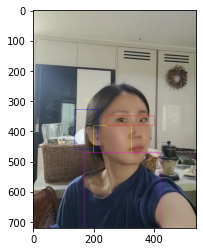

left cheek shape: (93, 124, 3)
y범위: 380~473
x범위: 208~332
left ear shape: (126, 74, 3)
y범위: 332~458
x범위: 146~220
eye shape: (27, 150, 3)
y범위: 353~380
x범위: 252~402
neck shape: (247, 244, 3)
y범위: 380~473
x범위: 177~421


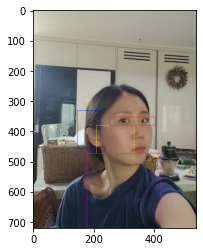

left cheek shape: (93, 127, 3)
y범위: 380~473
x범위: 215~342
left ear shape: (135, 75, 3)
y범위: 322~457
x범위: 152~227
eye shape: (33, 145, 3)
y범위: 347~380
x범위: 260~405
neck shape: (247, 241, 3)
y범위: 380~473
x범위: 184~425


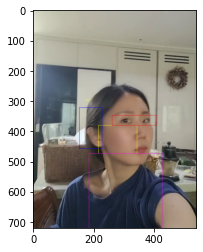

left cheek shape: (88, 131, 3)
y범위: 382~470
x범위: 220~351
left ear shape: (139, 80, 3)
y범위: 318~457
x범위: 155~235
eye shape: (39, 140, 3)
y범위: 343~382
x범위: 270~410
neck shape: (250, 244, 3)
y범위: 382~470
x범위: 188~432


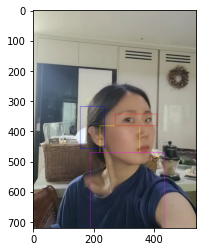

left cheek shape: (88, 132, 3)
y범위: 381~469
x범위: 226~358
left ear shape: (133, 80, 3)
y범위: 323~456
x범위: 160~240
eye shape: (31, 140, 3)
y범위: 350~381
x범위: 276~416
neck shape: (251, 246, 3)
y범위: 381~469
x범위: 193~439


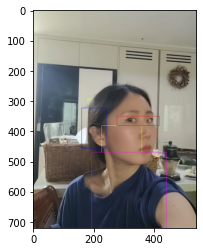

left cheek shape: (90, 133, 3)
y범위: 384~474
x범위: 231~364
left ear shape: (135, 80, 3)
y범위: 326~461
x범위: 165~245
eye shape: (37, 132, 3)
y범위: 347~384
x범위: 285~417
neck shape: (246, 244, 3)
y범위: 384~474
x범위: 198~442


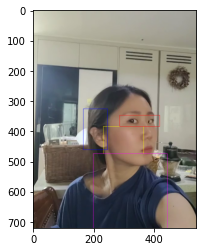

left cheek shape: (93, 132, 3)
y범위: 384~477
x범위: 232~364
left ear shape: (132, 78, 3)
y범위: 330~462
x범위: 166~244
eye shape: (30, 130, 3)
y범위: 354~384
x범위: 287~417
neck shape: (243, 243, 3)
y범위: 384~477
x범위: 199~442


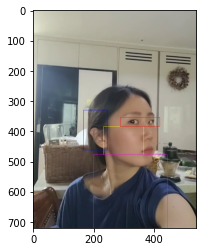

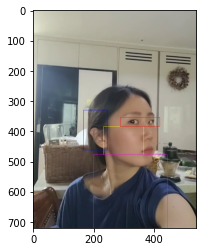

In [ ]:
# 웹캠 영상 입력
vid = []
for i in range(video.shape[0]):
  input_img = video[i,:,:,:] # video -> numpy
  x,y = file2frame(input_img)
  frame = im_trim(input_img, x, y,i)
  vid.append(frame)
HTML(plot_images(np.array(vid)).to_html5_video())
# boxing 영상 출력

left cheek shape: (30, 41, 3)
y범위: 86~116
x범위: 48~89
left ear shape: (47, 24, 3)
y범위: 65~112
x범위: 28~52
right cheek shape: (30, 22, 3)
y범위: 86~116
x범위: 101~123
right ear shape: (47, 24, 3)
y범위: 65~112
x범위: 119~143
eye shape: (13, 71, 3)
y범위: 73~86
x범위: 56~127
neck shape: (72, 95, 3)
y범위: 86~116
x범위: 38~133


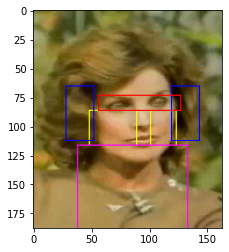

left cheek shape: (30, 41, 3)
y범위: 86~116
x범위: 48~89
left ear shape: (46, 24, 3)
y범위: 65~111
x범위: 28~52
right cheek shape: (30, 22, 3)
y범위: 86~116
x범위: 101~123
right ear shape: (46, 24, 3)
y범위: 65~111
x범위: 119~143
eye shape: (13, 71, 3)
y범위: 73~86
x범위: 56~127
neck shape: (72, 95, 3)
y범위: 86~116
x범위: 38~133


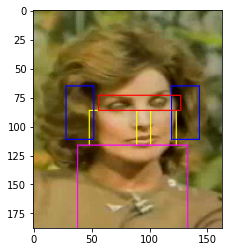

left cheek shape: (28, 41, 3)
y범위: 88~116
x범위: 48~89
left ear shape: (47, 25, 3)
y범위: 65~112
x범위: 28~53
right cheek shape: (28, 22, 3)
y범위: 88~116
x범위: 101~123
right ear shape: (47, 25, 3)
y범위: 65~112
x범위: 118~143
eye shape: (15, 75, 3)
y범위: 73~88
x범위: 53~128
neck shape: (72, 95, 3)
y범위: 88~116
x범위: 38~133


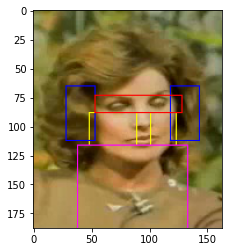

left cheek shape: (30, 41, 3)
y범위: 86~116
x범위: 48~89
left ear shape: (45, 24, 3)
y범위: 66~111
x범위: 28~52
right cheek shape: (30, 22, 3)
y범위: 86~116
x범위: 101~123
right ear shape: (45, 24, 3)
y범위: 66~111
x범위: 119~143
eye shape: (13, 72, 3)
y범위: 73~86
x범위: 54~126
neck shape: (72, 95, 3)
y범위: 86~116
x범위: 38~133


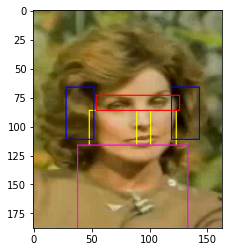

left cheek shape: (28, 40, 3)
y범위: 88~116
x범위: 47~87
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 27~52
right cheek shape: (28, 23, 3)
y범위: 88~116
x범위: 100~123
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 118~143
eye shape: (15, 72, 3)
y범위: 73~88
x범위: 54~126
neck shape: (72, 96, 3)
y범위: 88~116
x범위: 37~133


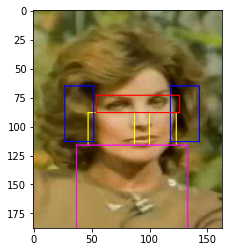

left cheek shape: (28, 42, 3)
y범위: 88~116
x범위: 47~89
left ear shape: (48, 26, 3)
y범위: 65~113
x범위: 26~52
eye shape: (15, 75, 3)
y범위: 73~88
x범위: 53~128
neck shape: (72, 95, 3)
y범위: 88~116
x범위: 37~132


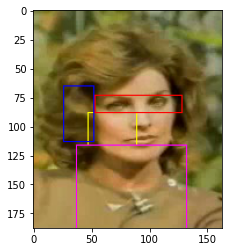

left cheek shape: (28, 42, 3)
y범위: 88~116
x범위: 46~88
left ear shape: (49, 26, 3)
y범위: 65~114
x범위: 25~51
eye shape: (15, 71, 3)
y범위: 73~88
x범위: 54~125
neck shape: (72, 96, 3)
y범위: 88~116
x범위: 36~132


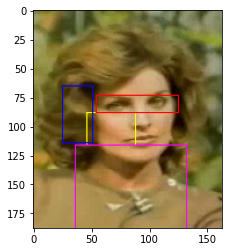

left cheek shape: (28, 41, 3)
y범위: 88~116
x범위: 47~88
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 27~52
right cheek shape: (28, 21, 3)
y범위: 88~116
x범위: 101~122
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 117~142
eye shape: (15, 71, 3)
y범위: 73~88
x범위: 54~125
neck shape: (72, 95, 3)
y범위: 88~116
x범위: 37~132


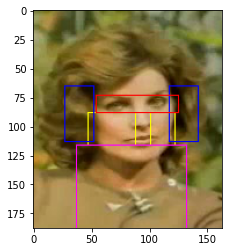

left cheek shape: (28, 40, 3)
y범위: 88~116
x범위: 47~87
left ear shape: (47, 25, 3)
y범위: 65~112
x범위: 27~52
right cheek shape: (28, 23, 3)
y범위: 88~116
x범위: 99~122
right ear shape: (47, 25, 3)
y범위: 65~112
x범위: 117~142
eye shape: (15, 72, 3)
y범위: 73~88
x범위: 53~125
neck shape: (72, 95, 3)
y범위: 88~116
x범위: 37~132


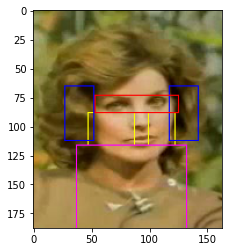

left cheek shape: (27, 41, 3)
y범위: 89~116
x범위: 46~87
left ear shape: (50, 26, 3)
y범위: 63~113
x범위: 26~52
right cheek shape: (27, 23, 3)
y범위: 89~116
x범위: 99~122
right ear shape: (50, 26, 3)
y범위: 63~113
x범위: 116~142
eye shape: (17, 72, 3)
y범위: 72~89
x범위: 53~125
neck shape: (72, 96, 3)
y범위: 89~116
x범위: 36~132


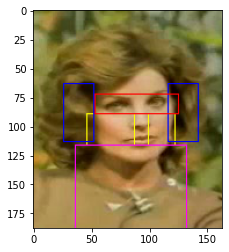

left cheek shape: (27, 42, 3)
y범위: 89~116
x범위: 46~88
left ear shape: (50, 27, 3)
y범위: 63~113
x범위: 25~52
right cheek shape: (27, 22, 3)
y범위: 89~116
x범위: 100~122
right ear shape: (50, 27, 3)
y범위: 63~113
x범위: 116~143
eye shape: (17, 72, 3)
y범위: 72~89
x범위: 53~125
neck shape: (72, 96, 3)
y범위: 89~116
x범위: 36~132


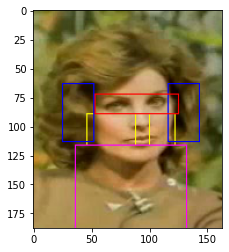

left cheek shape: (27, 40, 3)
y범위: 89~116
x범위: 46~86
left ear shape: (50, 26, 3)
y범위: 63~113
x범위: 26~52
right cheek shape: (27, 21, 3)
y범위: 89~116
x범위: 100~121
right ear shape: (50, 26, 3)
y범위: 63~113
x범위: 115~141
eye shape: (17, 71, 3)
y범위: 72~89
x범위: 53~124
neck shape: (72, 95, 3)
y범위: 89~116
x범위: 36~131


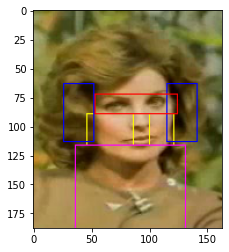

left cheek shape: (30, 41, 3)
y범위: 86~116
x범위: 46~87
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 26~50
right cheek shape: (30, 22, 3)
y범위: 86~116
x범위: 99~121
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 117~141
eye shape: (13, 75, 3)
y범위: 73~86
x범위: 51~126
neck shape: (72, 95, 3)
y범위: 86~116
x범위: 36~131


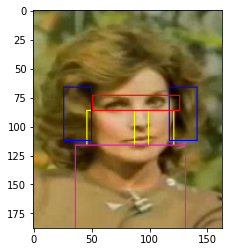

left cheek shape: (30, 41, 3)
y범위: 86~116
x범위: 46~87
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 26~50
right cheek shape: (30, 22, 3)
y범위: 86~116
x범위: 99~121
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 117~141
eye shape: (12, 75, 3)
y범위: 74~86
x범위: 51~126
neck shape: (72, 95, 3)
y범위: 86~116
x범위: 36~131


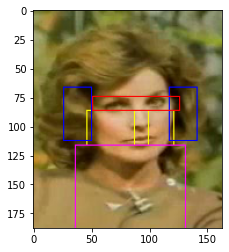

left cheek shape: (29, 42, 3)
y범위: 87~116
x범위: 44~86
left ear shape: (47, 25, 3)
y범위: 66~113
x범위: 23~48
right cheek shape: (29, 23, 3)
y범위: 87~116
x범위: 98~121
right ear shape: (47, 25, 3)
y범위: 66~113
x범위: 117~142
eye shape: (13, 72, 3)
y범위: 74~87
x범위: 52~124
neck shape: (72, 97, 3)
y범위: 87~116
x범위: 34~131


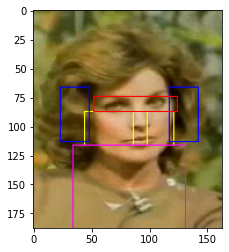

left cheek shape: (29, 42, 3)
y범위: 87~116
x범위: 44~86
left ear shape: (47, 25, 3)
y범위: 66~113
x범위: 23~48
right cheek shape: (29, 23, 3)
y범위: 87~116
x범위: 98~121
right ear shape: (47, 25, 3)
y범위: 66~113
x범위: 117~142
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 50~125
neck shape: (72, 97, 3)
y범위: 87~116
x범위: 34~131


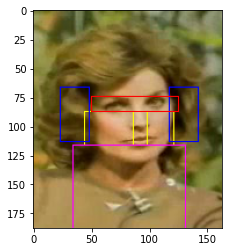

left cheek shape: (29, 43, 3)
y범위: 88~117
x범위: 43~86
left ear shape: (48, 26, 3)
y범위: 65~113
x범위: 22~48
right cheek shape: (29, 23, 3)
y범위: 88~117
x범위: 98~121
right ear shape: (48, 26, 3)
y범위: 65~113
x범위: 116~142
eye shape: (15, 72, 3)
y범위: 73~88
x범위: 52~124
neck shape: (71, 98, 3)
y범위: 88~117
x범위: 33~131


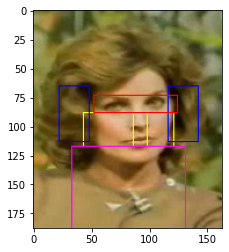

left cheek shape: (30, 42, 3)
y범위: 87~117
x범위: 44~86
left ear shape: (46, 25, 3)
y범위: 66~112
x범위: 23~48
right cheek shape: (30, 23, 3)
y범위: 87~117
x범위: 98~121
right ear shape: (46, 25, 3)
y범위: 66~112
x범위: 117~142
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 50~125
neck shape: (71, 97, 3)
y범위: 87~117
x범위: 34~131


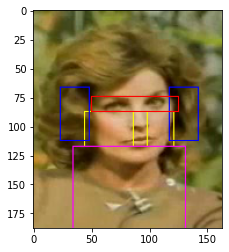

left cheek shape: (30, 41, 3)
y범위: 87~117
x범위: 44~85
left ear shape: (45, 24, 3)
y범위: 67~112
x범위: 24~48
right cheek shape: (30, 23, 3)
y범위: 87~117
x범위: 98~121
right ear shape: (45, 24, 3)
y범위: 67~112
x범위: 117~141
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 50~125
neck shape: (71, 97, 3)
y범위: 87~117
x범위: 34~131


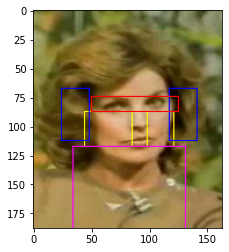

left cheek shape: (31, 41, 3)
y범위: 87~118
x범위: 44~85
left ear shape: (47, 24, 3)
y범위: 66~113
x범위: 24~48
right cheek shape: (31, 23, 3)
y범위: 87~118
x범위: 97~120
right ear shape: (47, 24, 3)
y범위: 66~113
x범위: 116~140
eye shape: (12, 72, 3)
y범위: 75~87
x범위: 52~124
neck shape: (70, 96, 3)
y범위: 87~118
x범위: 34~130


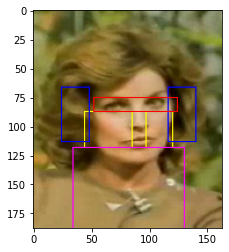

left cheek shape: (28, 40, 3)
y범위: 90~118
x범위: 45~85
left ear shape: (51, 26, 3)
y범위: 64~115
x범위: 25~51
right cheek shape: (28, 23, 3)
y범위: 90~118
x범위: 98~121
right ear shape: (51, 26, 3)
y범위: 64~115
x범위: 115~141
eye shape: (17, 75, 3)
y범위: 73~90
x범위: 50~125
neck shape: (70, 96, 3)
y범위: 90~118
x범위: 35~131


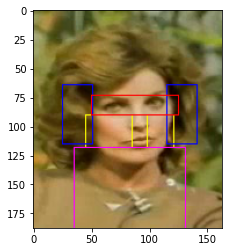

left cheek shape: (29, 40, 3)
y범위: 88~117
x범위: 45~85
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 25~50
right cheek shape: (29, 24, 3)
y범위: 88~117
x범위: 97~121
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 116~141
eye shape: (15, 72, 3)
y범위: 73~88
x범위: 52~124
neck shape: (71, 96, 3)
y범위: 88~117
x범위: 35~131


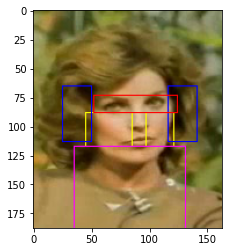

left cheek shape: (31, 40, 3)
y범위: 86~117
x범위: 45~85
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 25~49
right cheek shape: (31, 24, 3)
y범위: 86~117
x범위: 97~121
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 117~141
eye shape: (12, 72, 3)
y범위: 74~86
x범위: 52~124
neck shape: (71, 96, 3)
y범위: 86~117
x범위: 35~131


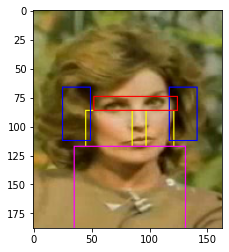

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 44~86
left ear shape: (47, 25, 3)
y범위: 66~113
x범위: 23~48
right cheek shape: (31, 23, 3)
y범위: 87~118
x범위: 98~121
right ear shape: (47, 25, 3)
y범위: 66~113
x범위: 117~142
eye shape: (12, 72, 3)
y범위: 75~87
x범위: 51~123
neck shape: (70, 97, 3)
y범위: 87~118
x범위: 34~131


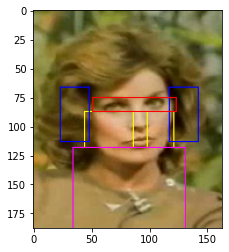

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 44~86
left ear shape: (47, 25, 3)
y범위: 66~113
x범위: 23~48
right cheek shape: (31, 22, 3)
y범위: 87~118
x범위: 98~120
right ear shape: (47, 25, 3)
y범위: 66~113
x범위: 116~141
eye shape: (13, 72, 3)
y범위: 74~87
x범위: 51~123
neck shape: (70, 96, 3)
y범위: 87~118
x범위: 34~130


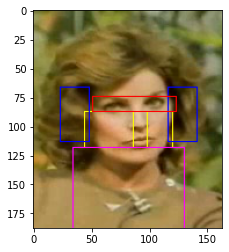

left cheek shape: (29, 41, 3)
y범위: 89~118
x범위: 44~85
left ear shape: (50, 25, 3)
y범위: 65~115
x범위: 24~49
right cheek shape: (29, 23, 3)
y범위: 89~118
x범위: 97~120
right ear shape: (50, 25, 3)
y범위: 65~115
x범위: 115~140
eye shape: (15, 72, 3)
y범위: 74~89
x범위: 51~123
neck shape: (70, 96, 3)
y범위: 89~118
x범위: 34~130


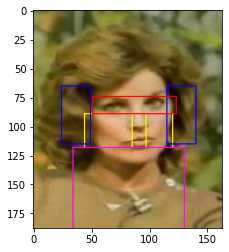

left cheek shape: (28, 41, 3)
y범위: 89~117
x범위: 44~85
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 24~49
right cheek shape: (28, 23, 3)
y범위: 89~117
x범위: 97~120
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 115~140
eye shape: (16, 72, 3)
y범위: 73~89
x범위: 51~123
neck shape: (71, 96, 3)
y범위: 89~117
x범위: 34~130


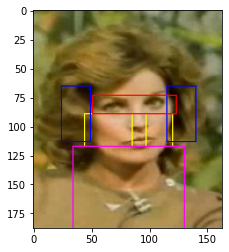

left cheek shape: (30, 40, 3)
y범위: 88~118
x범위: 44~84
left ear shape: (47, 24, 3)
y범위: 66~113
x범위: 24~48
right cheek shape: (30, 23, 3)
y범위: 88~118
x범위: 97~120
right ear shape: (47, 24, 3)
y범위: 66~113
x범위: 116~140
eye shape: (13, 72, 3)
y범위: 75~88
x범위: 51~123
neck shape: (70, 96, 3)
y범위: 88~118
x범위: 34~130


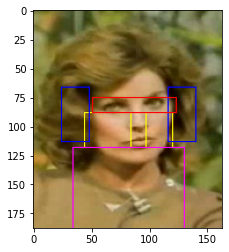

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 43~85
left ear shape: (46, 25, 3)
y범위: 67~113
x범위: 22~47
right cheek shape: (31, 23, 3)
y범위: 87~118
x범위: 97~120
right ear shape: (46, 25, 3)
y범위: 67~113
x범위: 116~141
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 49~124
neck shape: (70, 97, 3)
y범위: 87~118
x범위: 33~130


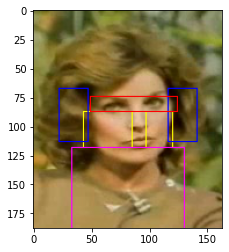

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 43~85
left ear shape: (46, 25, 3)
y범위: 67~113
x범위: 22~47
right cheek shape: (31, 22, 3)
y범위: 87~118
x범위: 98~120
right ear shape: (46, 25, 3)
y범위: 67~113
x범위: 116~141
eye shape: (13, 76, 3)
y범위: 74~87
x범위: 49~125
neck shape: (70, 97, 3)
y범위: 87~118
x범위: 33~130


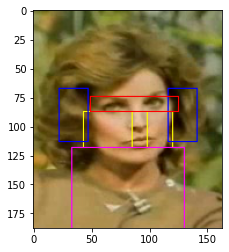

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 43~85
left ear shape: (46, 25, 3)
y범위: 67~113
x범위: 22~47
right cheek shape: (31, 22, 3)
y범위: 87~118
x범위: 98~120
right ear shape: (46, 25, 3)
y범위: 67~113
x범위: 116~141
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 49~124
neck shape: (70, 97, 3)
y범위: 87~118
x범위: 33~130


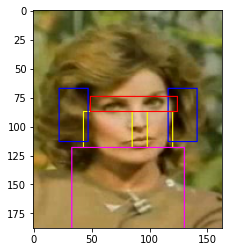

left cheek shape: (30, 41, 3)
y범위: 87~117
x범위: 44~85
left ear shape: (47, 24, 3)
y범위: 65~112
x범위: 24~48
right cheek shape: (30, 22, 3)
y범위: 87~117
x범위: 98~120
right ear shape: (47, 24, 3)
y범위: 65~112
x범위: 116~140
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 49~124
neck shape: (71, 96, 3)
y범위: 87~117
x범위: 34~130


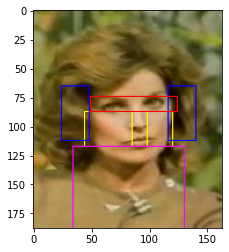

left cheek shape: (28, 42, 3)
y범위: 88~116
x범위: 42~84
left ear shape: (49, 26, 3)
y범위: 64~113
x범위: 21~47
right cheek shape: (28, 23, 3)
y범위: 88~116
x범위: 97~120
right ear shape: (49, 26, 3)
y범위: 64~113
x범위: 115~141
eye shape: (15, 76, 3)
y범위: 73~88
x범위: 48~124
neck shape: (72, 98, 3)
y범위: 88~116
x범위: 32~130


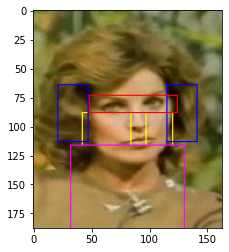

left cheek shape: (30, 43, 3)
y범위: 87~117
x범위: 41~84
left ear shape: (47, 25, 3)
y범위: 65~112
x범위: 20~45
right cheek shape: (30, 23, 3)
y범위: 87~117
x범위: 97~120
right ear shape: (47, 25, 3)
y범위: 65~112
x범위: 116~141
eye shape: (13, 76, 3)
y범위: 74~87
x범위: 48~124
neck shape: (71, 99, 3)
y범위: 87~117
x범위: 31~130


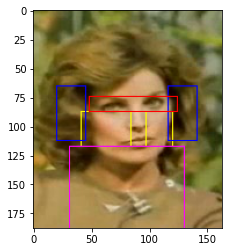

left cheek shape: (30, 43, 3)
y범위: 87~117
x범위: 42~85
left ear shape: (46, 25, 3)
y범위: 66~112
x범위: 21~46
right cheek shape: (30, 23, 3)
y범위: 87~117
x범위: 97~120
right ear shape: (46, 25, 3)
y범위: 66~112
x범위: 116~141
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 49~124
neck shape: (71, 98, 3)
y범위: 87~117
x범위: 32~130


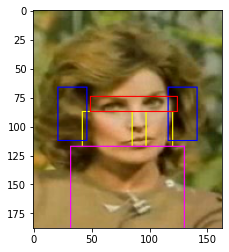

left cheek shape: (29, 43, 3)
y범위: 88~117
x범위: 42~85
left ear shape: (49, 26, 3)
y범위: 64~113
x범위: 21~47
right cheek shape: (29, 23, 3)
y범위: 88~117
x범위: 97~120
right ear shape: (49, 26, 3)
y범위: 64~113
x범위: 115~141
eye shape: (15, 77, 3)
y범위: 73~88
x범위: 48~125
neck shape: (71, 98, 3)
y범위: 88~117
x범위: 32~130


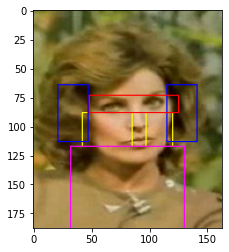

left cheek shape: (30, 41, 3)
y범위: 87~117
x범위: 42~83
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 22~46
right cheek shape: (30, 23, 3)
y범위: 87~117
x범위: 96~119
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 115~139
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 48~123
neck shape: (71, 97, 3)
y범위: 87~117
x범위: 32~129


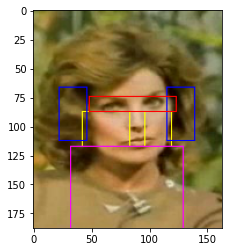

left cheek shape: (30, 41, 3)
y범위: 87~117
x범위: 42~83
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 22~46
right cheek shape: (30, 24, 3)
y범위: 87~117
x범위: 96~120
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 116~140
eye shape: (13, 75, 3)
y범위: 74~87
x범위: 48~123
neck shape: (71, 98, 3)
y범위: 87~117
x범위: 32~130


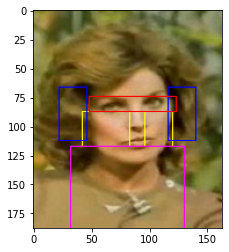

left cheek shape: (28, 41, 3)
y범위: 89~117
x범위: 43~84
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 23~48
right cheek shape: (28, 24, 3)
y범위: 89~117
x범위: 96~120
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 115~140
eye shape: (15, 76, 3)
y범위: 74~89
x범위: 48~124
neck shape: (71, 97, 3)
y범위: 89~117
x범위: 33~130


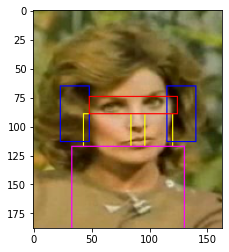

left cheek shape: (30, 41, 3)
y범위: 87~117
x범위: 42~83
left ear shape: (46, 24, 3)
y범위: 66~112
x범위: 22~46
right cheek shape: (30, 24, 3)
y범위: 87~117
x범위: 96~120
right ear shape: (46, 24, 3)
y범위: 66~112
x범위: 116~140
eye shape: (13, 76, 3)
y범위: 74~87
x범위: 47~123
neck shape: (71, 98, 3)
y범위: 87~117
x범위: 32~130


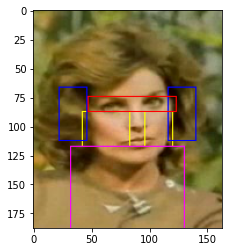

left cheek shape: (27, 43, 3)
y범위: 90~117
x범위: 42~85
left ear shape: (52, 27, 3)
y범위: 63~115
x범위: 21~48
right cheek shape: (27, 22, 3)
y범위: 90~117
x범위: 97~119
right ear shape: (52, 27, 3)
y범위: 63~115
x범위: 113~140
eye shape: (18, 76, 3)
y범위: 72~90
x범위: 48~124
neck shape: (71, 97, 3)
y범위: 90~117
x범위: 32~129


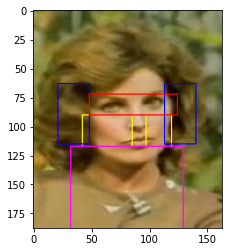

left cheek shape: (28, 42, 3)
y범위: 89~117
x범위: 42~84
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 21~47
right cheek shape: (28, 22, 3)
y범위: 89~117
x범위: 97~119
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 114~140
eye shape: (16, 77, 3)
y범위: 73~89
x범위: 47~124
neck shape: (71, 97, 3)
y범위: 89~117
x범위: 32~129


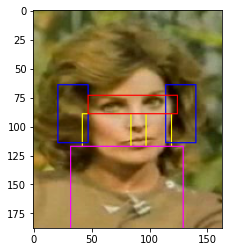

left cheek shape: (29, 42, 3)
y범위: 89~118
x범위: 42~84
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 21~47
right cheek shape: (29, 22, 3)
y범위: 89~118
x범위: 97~119
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 114~140
eye shape: (16, 77, 3)
y범위: 73~89
x범위: 47~124
neck shape: (70, 97, 3)
y범위: 89~118
x범위: 32~129


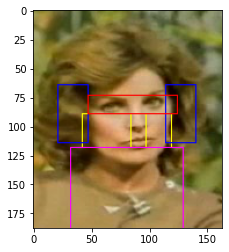

left cheek shape: (31, 41, 3)
y범위: 87~118
x범위: 42~83
left ear shape: (48, 24, 3)
y범위: 65~113
x범위: 22~46
right cheek shape: (31, 23, 3)
y범위: 87~118
x범위: 96~119
right ear shape: (48, 24, 3)
y범위: 65~113
x범위: 115~139
eye shape: (13, 76, 3)
y범위: 74~87
x범위: 47~123
neck shape: (70, 97, 3)
y범위: 87~118
x범위: 32~129


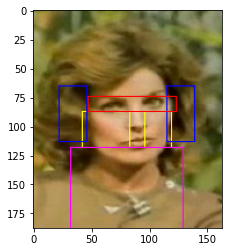

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 42~84
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 21~47
right cheek shape: (30, 22, 3)
y범위: 88~118
x범위: 97~119
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 114~140
eye shape: (15, 76, 3)
y범위: 73~88
x범위: 48~124
neck shape: (70, 97, 3)
y범위: 88~118
x범위: 32~129


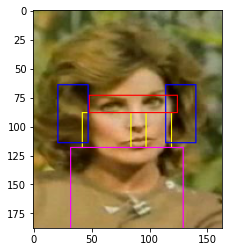

left cheek shape: (29, 42, 3)
y범위: 90~119
x범위: 42~84
left ear shape: (52, 27, 3)
y범위: 64~116
x범위: 21~48
right cheek shape: (29, 23, 3)
y범위: 90~119
x범위: 97~120
right ear shape: (52, 27, 3)
y범위: 64~116
x범위: 114~141
eye shape: (17, 76, 3)
y범위: 73~90
x범위: 48~124
neck shape: (69, 98, 3)
y범위: 90~119
x범위: 32~130


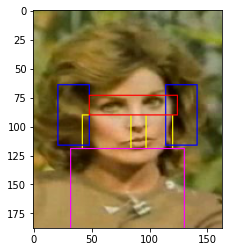

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 42~84
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 21~47
right cheek shape: (30, 23, 3)
y범위: 88~118
x범위: 97~120
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 115~141
eye shape: (16, 76, 3)
y범위: 72~88
x범위: 47~123
neck shape: (70, 98, 3)
y범위: 88~118
x범위: 32~130


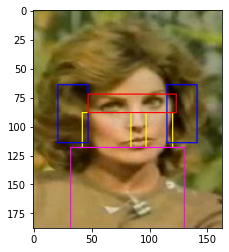

left cheek shape: (29, 41, 3)
y범위: 88~117
x범위: 43~84
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 23~48
right cheek shape: (29, 23, 3)
y범위: 88~117
x범위: 97~120
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 115~140
eye shape: (17, 76, 3)
y범위: 71~88
x범위: 48~124
neck shape: (71, 97, 3)
y범위: 88~117
x범위: 33~130


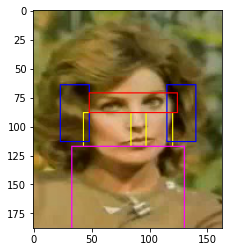

left cheek shape: (29, 41, 3)
y범위: 88~117
x범위: 42~83
left ear shape: (50, 25, 3)
y범위: 64~114
x범위: 22~47
right cheek shape: (29, 24, 3)
y범위: 88~117
x범위: 96~120
right ear shape: (50, 25, 3)
y범위: 64~114
x범위: 115~140
eye shape: (16, 77, 3)
y범위: 72~88
x범위: 47~124
neck shape: (71, 98, 3)
y범위: 88~117
x범위: 32~130


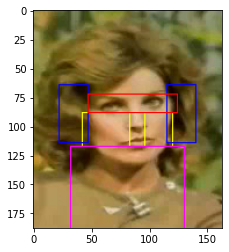

left cheek shape: (28, 42, 3)
y범위: 89~117
x범위: 41~83
left ear shape: (51, 27, 3)
y범위: 63~114
x범위: 20~47
right cheek shape: (28, 24, 3)
y범위: 89~117
x범위: 96~120
right ear shape: (51, 27, 3)
y범위: 63~114
x범위: 114~141
eye shape: (18, 76, 3)
y범위: 71~89
x범위: 48~124
neck shape: (71, 99, 3)
y범위: 89~117
x범위: 31~130


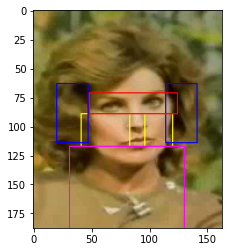

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 41~83
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 20~46
right cheek shape: (30, 24, 3)
y범위: 88~118
x범위: 96~120
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 115~141
eye shape: (16, 76, 3)
y범위: 72~88
x범위: 48~124
neck shape: (70, 99, 3)
y범위: 88~118
x범위: 31~130


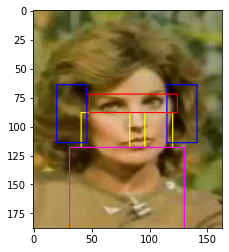

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 41~83
left ear shape: (51, 26, 3)
y범위: 63~114
x범위: 20~46
right cheek shape: (30, 24, 3)
y범위: 88~118
x범위: 96~120
right ear shape: (51, 26, 3)
y범위: 63~114
x범위: 115~141
eye shape: (16, 76, 3)
y범위: 72~88
x범위: 48~124
neck shape: (70, 99, 3)
y범위: 88~118
x범위: 31~130


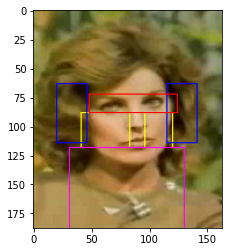

left cheek shape: (32, 41, 3)
y범위: 86~118
x범위: 42~83
left ear shape: (49, 24, 3)
y범위: 64~113
x범위: 22~46
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 96~120
right ear shape: (49, 24, 3)
y범위: 64~113
x범위: 116~140
eye shape: (13, 76, 3)
y범위: 73~86
x범위: 48~124
neck shape: (70, 98, 3)
y범위: 86~118
x범위: 32~130


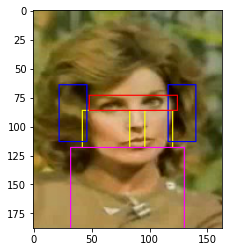

left cheek shape: (32, 42, 3)
y범위: 86~118
x범위: 41~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 20~45
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 96~120
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 116~141
eye shape: (13, 76, 3)
y범위: 73~86
x범위: 48~124
neck shape: (70, 99, 3)
y범위: 86~118
x범위: 31~130


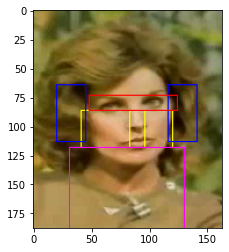

left cheek shape: (32, 42, 3)
y범위: 86~118
x범위: 41~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 20~45
right cheek shape: (32, 25, 3)
y범위: 86~118
x범위: 96~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 76, 3)
y범위: 73~86
x범위: 48~124
neck shape: (70, 100, 3)
y범위: 86~118
x범위: 31~131


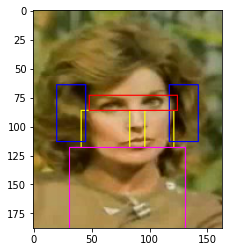

left cheek shape: (29, 42, 3)
y범위: 89~118
x범위: 41~83
left ear shape: (52, 27, 3)
y범위: 63~115
x범위: 20~47
right cheek shape: (29, 24, 3)
y범위: 89~118
x범위: 96~120
right ear shape: (52, 27, 3)
y범위: 63~115
x범위: 114~141
eye shape: (18, 76, 3)
y범위: 71~89
x범위: 48~124
neck shape: (70, 99, 3)
y범위: 89~118
x범위: 31~130


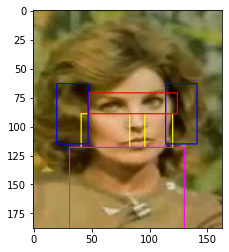

left cheek shape: (32, 42, 3)
y범위: 86~118
x범위: 41~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 20~45
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 96~120
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 116~141
eye shape: (13, 75, 3)
y범위: 73~86
x범위: 48~123
neck shape: (70, 99, 3)
y범위: 86~118
x범위: 31~130


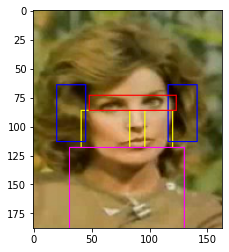

left cheek shape: (32, 42, 3)
y범위: 86~118
x범위: 41~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 20~45
right cheek shape: (32, 25, 3)
y범위: 86~118
x범위: 96~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 80, 3)
y범위: 73~86
x범위: 46~126
neck shape: (70, 100, 3)
y범위: 86~118
x범위: 31~131


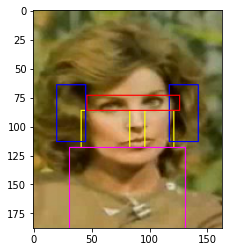

left cheek shape: (32, 42, 3)
y범위: 86~118
x범위: 41~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 20~45
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 97~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 80, 3)
y범위: 73~86
x범위: 46~126
neck shape: (70, 100, 3)
y범위: 86~118
x범위: 31~131


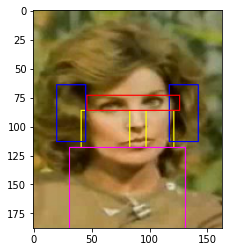

left cheek shape: (32, 43, 3)
y범위: 86~118
x범위: 40~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 19~44
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 97~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 80, 3)
y범위: 73~86
x범위: 46~126
neck shape: (70, 101, 3)
y범위: 86~118
x범위: 30~131


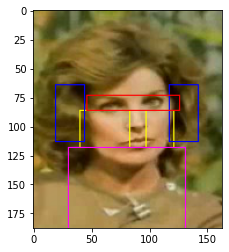

left cheek shape: (32, 43, 3)
y범위: 86~118
x범위: 39~82
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 18~43
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 97~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 77, 3)
y범위: 73~86
x범위: 47~124
neck shape: (70, 102, 3)
y범위: 86~118
x범위: 29~131


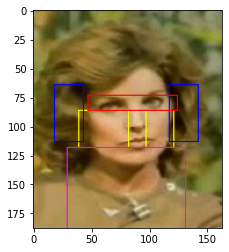

left cheek shape: (32, 43, 3)
y범위: 86~118
x범위: 40~83
left ear shape: (49, 25, 3)
y범위: 64~113
x범위: 19~44
right cheek shape: (32, 26, 3)
y범위: 86~118
x범위: 95~121
right ear shape: (49, 25, 3)
y범위: 64~113
x범위: 117~142
eye shape: (13, 76, 3)
y범위: 73~86
x범위: 47~123
neck shape: (70, 101, 3)
y범위: 86~118
x범위: 30~131


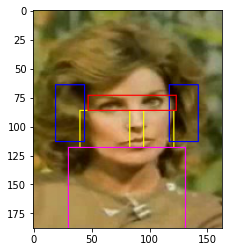

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 41~83
left ear shape: (51, 26, 3)
y범위: 63~114
x범위: 20~46
right cheek shape: (30, 25, 3)
y범위: 88~118
x범위: 96~121
right ear shape: (51, 26, 3)
y범위: 63~114
x범위: 116~142
eye shape: (16, 76, 3)
y범위: 72~88
x범위: 47~123
neck shape: (70, 100, 3)
y범위: 88~118
x범위: 31~131


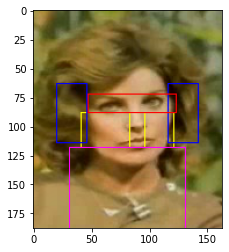

left cheek shape: (30, 42, 3)
y범위: 88~118
x범위: 41~83
left ear shape: (51, 26, 3)
y범위: 64~115
x범위: 20~46
right cheek shape: (30, 26, 3)
y범위: 88~118
x범위: 95~121
right ear shape: (51, 26, 3)
y범위: 64~115
x범위: 116~142
eye shape: (15, 76, 3)
y범위: 73~88
x범위: 47~123
neck shape: (70, 100, 3)
y범위: 88~118
x범위: 31~131


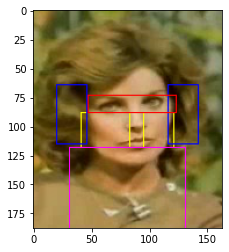

left cheek shape: (30, 44, 3)
y범위: 88~118
x범위: 40~84
left ear shape: (51, 27, 3)
y범위: 63~114
x범위: 18~45
right cheek shape: (30, 24, 3)
y범위: 88~118
x범위: 97~121
right ear shape: (51, 27, 3)
y범위: 63~114
x범위: 116~143
eye shape: (16, 77, 3)
y범위: 72~88
x범위: 47~124
neck shape: (70, 103, 3)
y범위: 88~118
x범위: 29~132


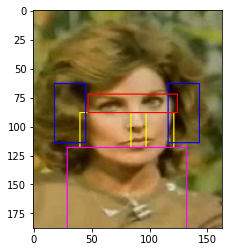

left cheek shape: (29, 42, 3)
y범위: 89~118
x범위: 40~82
left ear shape: (52, 27, 3)
y범위: 63~115
x범위: 19~46
right cheek shape: (29, 25, 3)
y범위: 89~118
x범위: 95~120
right ear shape: (52, 27, 3)
y범위: 63~115
x범위: 114~141
eye shape: (18, 76, 3)
y범위: 71~89
x범위: 47~123
neck shape: (70, 100, 3)
y범위: 89~118
x범위: 30~130


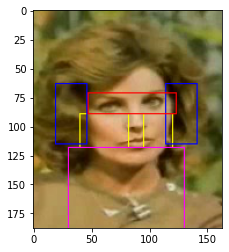

left cheek shape: (31, 42, 3)
y범위: 87~118
x범위: 40~82
left ear shape: (49, 25, 3)
y범위: 65~114
x범위: 19~44
right cheek shape: (31, 25, 3)
y범위: 87~118
x범위: 95~120
right ear shape: (49, 25, 3)
y범위: 65~114
x범위: 116~141
eye shape: (13, 76, 3)
y범위: 74~87
x범위: 47~123
neck shape: (70, 100, 3)
y범위: 87~118
x범위: 30~130


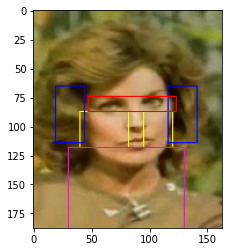

left cheek shape: (30, 43, 3)
y범위: 88~118
x범위: 39~82
left ear shape: (51, 26, 3)
y범위: 63~114
x범위: 18~44
right cheek shape: (30, 25, 3)
y범위: 88~118
x범위: 95~120
right ear shape: (51, 26, 3)
y범위: 63~114
x범위: 115~141
eye shape: (17, 77, 3)
y범위: 71~88
x범위: 47~124
neck shape: (70, 101, 3)
y범위: 88~118
x범위: 29~130


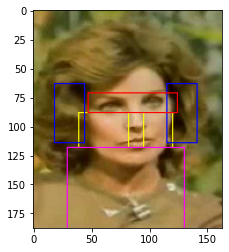

left cheek shape: (30, 43, 3)
y범위: 88~118
x범위: 40~83
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 19~45
right cheek shape: (30, 24, 3)
y범위: 88~118
x범위: 96~120
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 115~141
eye shape: (17, 81, 3)
y범위: 71~88
x범위: 44~125
neck shape: (70, 100, 3)
y범위: 88~118
x범위: 30~130


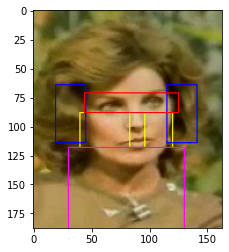

left cheek shape: (29, 43, 3)
y범위: 89~118
x범위: 40~83
left ear shape: (54, 27, 3)
y범위: 61~115
x범위: 19~46
right cheek shape: (29, 24, 3)
y범위: 89~118
x범위: 96~120
right ear shape: (54, 27, 3)
y범위: 61~115
x범위: 114~141
eye shape: (19, 81, 3)
y범위: 70~89
x범위: 44~125
neck shape: (70, 100, 3)
y범위: 89~118
x범위: 30~130


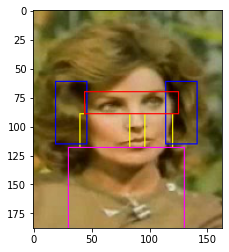

left cheek shape: (30, 43, 3)
y범위: 88~118
x범위: 39~82
left ear shape: (50, 26, 3)
y범위: 64~114
x범위: 18~44
right cheek shape: (30, 25, 3)
y범위: 88~118
x범위: 95~120
right ear shape: (50, 26, 3)
y범위: 64~114
x범위: 115~141
eye shape: (17, 80, 3)
y범위: 71~88
x범위: 44~124
neck shape: (70, 101, 3)
y범위: 88~118
x범위: 29~130


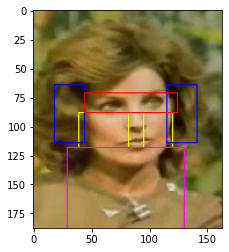

left cheek shape: (32, 41, 3)
y범위: 86~118
x범위: 41~82
left ear shape: (49, 24, 3)
y범위: 64~113
x범위: 21~45
right cheek shape: (32, 24, 3)
y범위: 86~118
x범위: 96~120
right ear shape: (49, 24, 3)
y범위: 64~113
x범위: 116~140
eye shape: (13, 81, 3)
y범위: 73~86
x범위: 44~125
neck shape: (70, 99, 3)
y범위: 86~118
x범위: 31~130


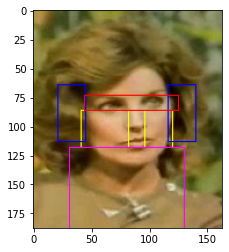

left cheek shape: (29, 43, 3)
y범위: 89~118
x범위: 39~82
left ear shape: (54, 27, 3)
y범위: 61~115
x범위: 18~45
right cheek shape: (29, 25, 3)
y범위: 89~118
x범위: 95~120
right ear shape: (54, 27, 3)
y범위: 61~115
x범위: 114~141
eye shape: (19, 80, 3)
y범위: 70~89
x범위: 44~124
neck shape: (70, 101, 3)
y범위: 89~118
x범위: 29~130


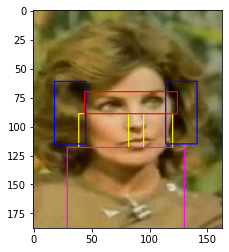

left cheek shape: (30, 43, 3)
y범위: 88~118
x범위: 39~82
left ear shape: (51, 26, 3)
y범위: 63~114
x범위: 18~44
right cheek shape: (30, 25, 3)
y범위: 88~118
x범위: 95~120
right ear shape: (51, 26, 3)
y범위: 63~114
x범위: 115~141
eye shape: (15, 80, 3)
y범위: 73~88
x범위: 44~124
neck shape: (70, 101, 3)
y범위: 88~118
x범위: 29~130


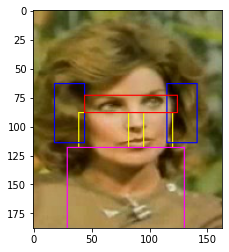

left cheek shape: (31, 43, 3)
y범위: 87~118
x범위: 39~82
left ear shape: (48, 25, 3)
y범위: 65~113
x범위: 18~43
right cheek shape: (31, 25, 3)
y범위: 87~118
x범위: 95~120
right ear shape: (48, 25, 3)
y범위: 65~113
x범위: 116~141
eye shape: (13, 80, 3)
y범위: 74~87
x범위: 44~124
neck shape: (70, 101, 3)
y범위: 87~118
x범위: 29~130


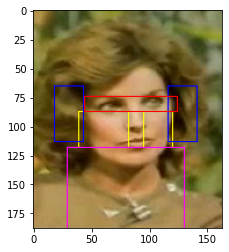

left cheek shape: (29, 43, 3)
y범위: 90~119
x범위: 39~82
left ear shape: (54, 27, 3)
y범위: 62~116
x범위: 18~45
right cheek shape: (29, 25, 3)
y범위: 90~119
x범위: 95~120
right ear shape: (54, 27, 3)
y범위: 62~116
x범위: 114~141
eye shape: (19, 80, 3)
y범위: 71~90
x범위: 44~124
neck shape: (69, 101, 3)
y범위: 90~119
x범위: 29~130


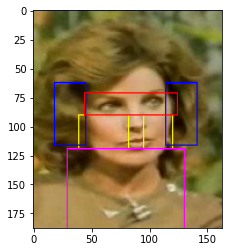

left cheek shape: (31, 43, 3)
y범위: 88~119
x범위: 39~82
left ear shape: (52, 26, 3)
y범위: 63~115
x범위: 18~44
right cheek shape: (31, 25, 3)
y범위: 88~119
x범위: 95~120
right ear shape: (52, 26, 3)
y범위: 63~115
x범위: 115~141
eye shape: (16, 80, 3)
y범위: 72~88
x범위: 44~124
neck shape: (69, 101, 3)
y범위: 88~119
x범위: 29~130


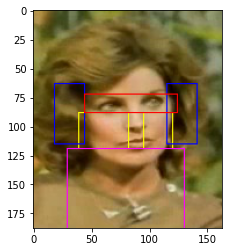

left cheek shape: (33, 42, 3)
y범위: 86~119
x범위: 40~82
left ear shape: (50, 25, 3)
y범위: 64~114
x범위: 19~44
right cheek shape: (33, 25, 3)
y범위: 86~119
x범위: 95~120
right ear shape: (50, 25, 3)
y범위: 64~114
x범위: 116~141
eye shape: (13, 80, 3)
y범위: 73~86
x범위: 44~124
neck shape: (69, 100, 3)
y범위: 86~119
x범위: 30~130


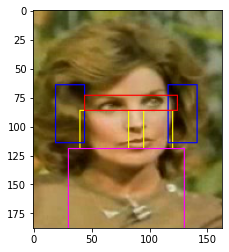

left cheek shape: (33, 43, 3)
y범위: 86~119
x범위: 39~82
left ear shape: (50, 25, 3)
y범위: 64~114
x범위: 18~43
right cheek shape: (33, 25, 3)
y범위: 86~119
x범위: 95~120
right ear shape: (50, 25, 3)
y범위: 64~114
x범위: 116~141
eye shape: (13, 80, 3)
y범위: 73~86
x범위: 44~124
neck shape: (69, 101, 3)
y범위: 86~119
x범위: 29~130


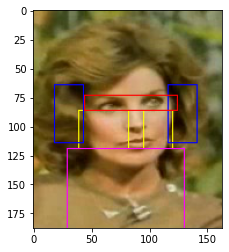

left cheek shape: (31, 42, 3)
y범위: 88~119
x범위: 40~82
left ear shape: (52, 26, 3)
y범위: 63~115
x범위: 19~45
right cheek shape: (31, 25, 3)
y범위: 88~119
x범위: 95~120
right ear shape: (52, 26, 3)
y범위: 63~115
x범위: 115~141
eye shape: (16, 80, 3)
y범위: 72~88
x범위: 44~124
neck shape: (69, 100, 3)
y범위: 88~119
x범위: 30~130


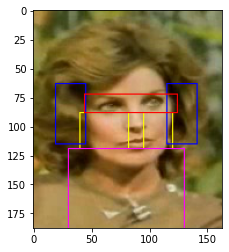

left cheek shape: (29, 43, 3)
y범위: 89~118
x범위: 40~83
left ear shape: (54, 27, 3)
y범위: 62~116
x범위: 19~46
right cheek shape: (29, 24, 3)
y범위: 89~118
x범위: 96~120
right ear shape: (54, 27, 3)
y범위: 62~116
x범위: 114~141
eye shape: (18, 81, 3)
y범위: 71~89
x범위: 44~125
neck shape: (70, 100, 3)
y범위: 89~118
x범위: 30~130


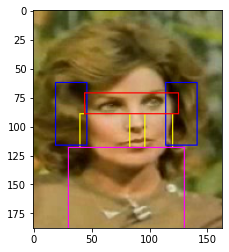

left cheek shape: (30, 43, 3)
y범위: 89~119
x범위: 40~83
left ear shape: (54, 27, 3)
y범위: 62~116
x범위: 19~46
right cheek shape: (30, 24, 3)
y범위: 89~119
x범위: 96~120
right ear shape: (54, 27, 3)
y범위: 62~116
x범위: 114~141
eye shape: (18, 81, 3)
y범위: 71~89
x범위: 44~125
neck shape: (69, 100, 3)
y범위: 89~119
x범위: 30~130


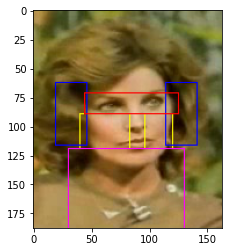

left cheek shape: (29, 43, 3)
y범위: 89~118
x범위: 40~83
left ear shape: (54, 27, 3)
y범위: 62~116
x범위: 19~46
right cheek shape: (29, 24, 3)
y범위: 89~118
x범위: 96~120
right ear shape: (54, 27, 3)
y범위: 62~116
x범위: 114~141
eye shape: (19, 81, 3)
y범위: 70~89
x범위: 44~125
neck shape: (70, 100, 3)
y범위: 89~118
x범위: 30~130


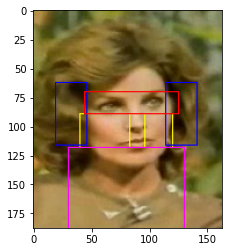

left cheek shape: (31, 44, 3)
y범위: 88~119
x범위: 38~82
left ear shape: (51, 27, 3)
y범위: 64~115
x범위: 16~43
right cheek shape: (31, 25, 3)
y범위: 88~119
x범위: 96~121
right ear shape: (51, 27, 3)
y범위: 64~115
x범위: 116~143
eye shape: (15, 81, 3)
y범위: 73~88
x범위: 44~125
neck shape: (69, 105, 3)
y범위: 88~119
x범위: 27~132


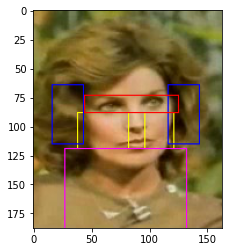

left cheek shape: (29, 43, 3)
y범위: 90~119
x범위: 39~82
left ear shape: (54, 27, 3)
y범위: 63~117
x범위: 18~45
right cheek shape: (29, 25, 3)
y범위: 90~119
x범위: 95~120
right ear shape: (54, 27, 3)
y범위: 63~117
x범위: 114~141
eye shape: (18, 80, 3)
y범위: 72~90
x범위: 44~124
neck shape: (69, 101, 3)
y범위: 90~119
x범위: 29~130


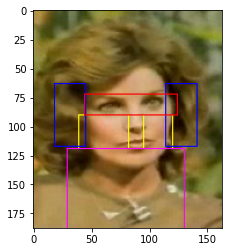

left cheek shape: (31, 44, 3)
y범위: 89~120
x범위: 38~82
left ear shape: (55, 28, 3)
y범위: 62~117
x범위: 16~44
right cheek shape: (31, 25, 3)
y범위: 89~120
x범위: 95~120
right ear shape: (55, 28, 3)
y범위: 62~117
x범위: 114~142
eye shape: (17, 80, 3)
y범위: 72~89
x범위: 44~124
neck shape: (68, 104, 3)
y범위: 89~120
x범위: 27~131


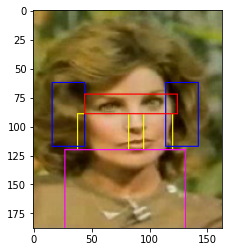

left cheek shape: (32, 43, 3)
y범위: 88~120
x범위: 38~81
left ear shape: (52, 26, 3)
y범위: 63~115
x범위: 17~43
right cheek shape: (32, 25, 3)
y범위: 88~120
x범위: 95~120
right ear shape: (52, 26, 3)
y범위: 63~115
x범위: 115~141
eye shape: (16, 80, 3)
y범위: 72~88
x범위: 44~124
neck shape: (68, 102, 3)
y범위: 88~120
x범위: 28~130


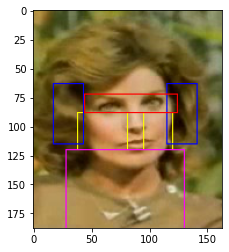

left cheek shape: (30, 42, 3)
y범위: 90~120
x범위: 39~81
left ear shape: (53, 27, 3)
y범위: 63~116
x범위: 18~45
right cheek shape: (30, 26, 3)
y범위: 90~120
x범위: 94~120
right ear shape: (53, 27, 3)
y범위: 63~116
x범위: 114~141
eye shape: (17, 81, 3)
y범위: 73~90
x범위: 43~124
neck shape: (68, 101, 3)
y범위: 90~120
x범위: 29~130


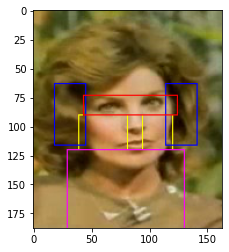

left cheek shape: (32, 43, 3)
y범위: 88~120
x범위: 38~81
left ear shape: (50, 25, 3)
y범위: 66~116
x범위: 17~42
right cheek shape: (32, 26, 3)
y범위: 88~120
x범위: 94~120
right ear shape: (50, 25, 3)
y범위: 66~116
x범위: 116~141
eye shape: (13, 81, 3)
y범위: 75~88
x범위: 43~124
neck shape: (68, 102, 3)
y범위: 88~120
x범위: 28~130


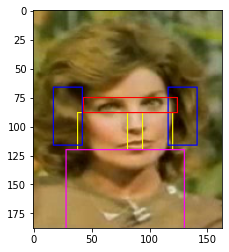

left cheek shape: (30, 42, 3)
y범위: 90~120
x범위: 39~81
left ear shape: (53, 27, 3)
y범위: 64~117
x범위: 18~45
right cheek shape: (30, 26, 3)
y범위: 90~120
x범위: 94~120
right ear shape: (53, 27, 3)
y범위: 64~117
x범위: 114~141
eye shape: (18, 80, 3)
y범위: 72~90
x범위: 44~124
neck shape: (68, 101, 3)
y범위: 90~120
x범위: 29~130


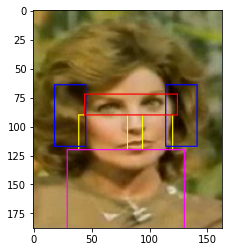

left cheek shape: (31, 43, 3)
y범위: 91~122
x범위: 38~81
left ear shape: (54, 27, 3)
y범위: 64~118
x범위: 17~44
right cheek shape: (31, 26, 3)
y범위: 91~122
x범위: 94~120
right ear shape: (54, 27, 3)
y범위: 64~118
x범위: 114~141
eye shape: (18, 82, 3)
y범위: 73~91
x범위: 43~125
neck shape: (66, 102, 3)
y범위: 91~122
x범위: 28~130


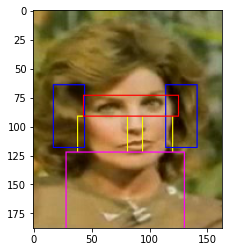

left cheek shape: (29, 43, 3)
y범위: 91~120
x범위: 38~81
left ear shape: (53, 27, 3)
y범위: 64~117
x범위: 17~44
right cheek shape: (29, 25, 3)
y범위: 91~120
x범위: 95~120
right ear shape: (53, 27, 3)
y범위: 64~117
x범위: 114~141
eye shape: (19, 81, 3)
y범위: 72~91
x범위: 43~124
neck shape: (68, 102, 3)
y범위: 91~120
x범위: 28~130


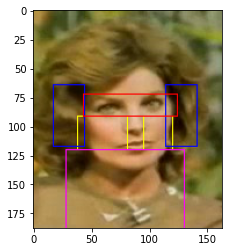

left cheek shape: (30, 45, 3)
y범위: 91~121
x범위: 37~82
left ear shape: (53, 28, 3)
y범위: 64~117
x범위: 15~43
right cheek shape: (30, 25, 3)
y범위: 91~121
x범위: 96~121
right ear shape: (53, 28, 3)
y범위: 64~117
x범위: 115~143
eye shape: (17, 81, 3)
y범위: 74~91
x범위: 44~125
neck shape: (67, 106, 3)
y범위: 91~121
x범위: 26~132


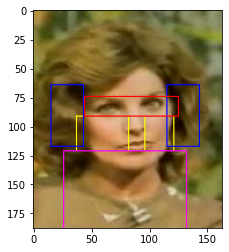

left cheek shape: (30, 43, 3)
y범위: 91~121
x범위: 38~81
left ear shape: (55, 27, 3)
y범위: 64~119
x범위: 17~44
right cheek shape: (30, 27, 3)
y범위: 91~121
x범위: 94~121
right ear shape: (55, 27, 3)
y범위: 64~119
x범위: 115~142
eye shape: (17, 82, 3)
y범위: 74~91
x범위: 43~125
neck shape: (67, 103, 3)
y범위: 91~121
x범위: 28~131


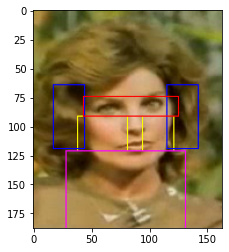

left cheek shape: (31, 44, 3)
y범위: 90~121
x범위: 37~81
left ear shape: (53, 27, 3)
y범위: 65~118
x범위: 15~42
right cheek shape: (31, 25, 3)
y범위: 90~121
x범위: 94~119
right ear shape: (53, 27, 3)
y범위: 65~118
x범위: 114~141
eye shape: (15, 82, 3)
y범위: 75~90
x범위: 43~125
neck shape: (67, 104, 3)
y범위: 90~121
x범위: 26~130


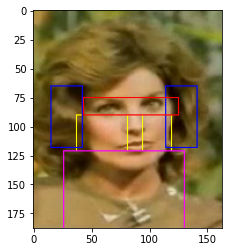

left cheek shape: (33, 43, 3)
y범위: 88~121
x범위: 38~81
left ear shape: (49, 25, 3)
y범위: 67~116
x범위: 17~42
right cheek shape: (33, 25, 3)
y범위: 88~121
x범위: 94~119
right ear shape: (49, 25, 3)
y범위: 67~116
x범위: 115~140
eye shape: (13, 80, 3)
y범위: 75~88
x범위: 43~123
neck shape: (67, 101, 3)
y범위: 88~121
x범위: 28~129


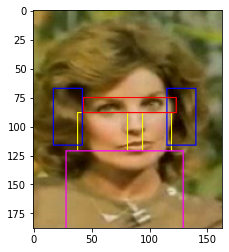

left cheek shape: (32, 43, 3)
y범위: 90~122
x범위: 38~81
left ear shape: (52, 26, 3)
y범위: 65~117
x범위: 17~43
right cheek shape: (32, 25, 3)
y범위: 90~122
x범위: 94~119
right ear shape: (52, 26, 3)
y범위: 65~117
x범위: 114~140
eye shape: (16, 81, 3)
y범위: 74~90
x범위: 42~123
neck shape: (66, 101, 3)
y범위: 90~122
x범위: 28~129


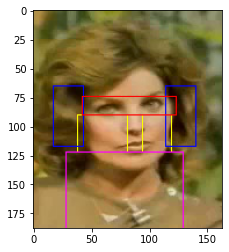

left cheek shape: (30, 44, 3)
y범위: 91~121
x범위: 37~81
left ear shape: (54, 28, 3)
y범위: 65~119
x범위: 15~43
right cheek shape: (30, 25, 3)
y범위: 91~121
x범위: 94~119
right ear shape: (54, 28, 3)
y범위: 65~119
x범위: 113~141
eye shape: (17, 81, 3)
y범위: 74~91
x범위: 42~123
neck shape: (67, 104, 3)
y범위: 91~121
x범위: 26~130


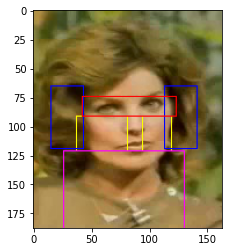

left cheek shape: (30, 43, 3)
y범위: 91~121
x범위: 38~81
left ear shape: (55, 27, 3)
y범위: 64~119
x범위: 17~44
right cheek shape: (30, 25, 3)
y범위: 91~121
x범위: 94~119
right ear shape: (55, 27, 3)
y범위: 64~119
x범위: 113~140
eye shape: (17, 81, 3)
y범위: 74~91
x범위: 42~123
neck shape: (67, 101, 3)
y범위: 91~121
x범위: 28~129


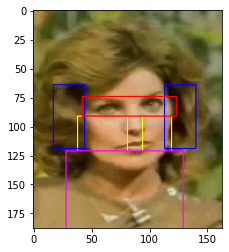

left cheek shape: (32, 42, 3)
y범위: 90~122
x범위: 38~80
left ear shape: (52, 26, 3)
y범위: 65~117
x범위: 17~43
right cheek shape: (32, 25, 3)
y범위: 90~122
x범위: 94~119
right ear shape: (52, 26, 3)
y범위: 65~117
x범위: 114~140
eye shape: (16, 81, 3)
y범위: 74~90
x범위: 42~123
neck shape: (66, 101, 3)
y범위: 90~122
x범위: 28~129


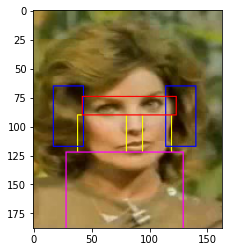

left cheek shape: (34, 44, 3)
y범위: 88~122
x범위: 36~80
left ear shape: (49, 26, 3)
y범위: 67~116
x범위: 14~40
right cheek shape: (34, 26, 3)
y범위: 88~122
x범위: 93~119
right ear shape: (49, 26, 3)
y범위: 67~116
x범위: 115~141
eye shape: (13, 85, 3)
y범위: 75~88
x범위: 40~125
neck shape: (66, 105, 3)
y범위: 88~122
x범위: 25~130


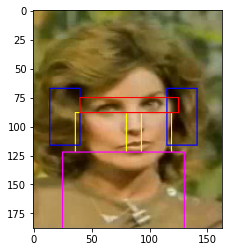

left cheek shape: (32, 44, 3)
y범위: 90~122
x범위: 36~80
left ear shape: (53, 27, 3)
y범위: 65~118
x범위: 14~41
right cheek shape: (32, 25, 3)
y범위: 90~122
x범위: 93~118
right ear shape: (53, 27, 3)
y범위: 65~118
x범위: 113~140
eye shape: (16, 81, 3)
y범위: 74~90
x범위: 41~122
neck shape: (66, 104, 3)
y범위: 90~122
x범위: 25~129


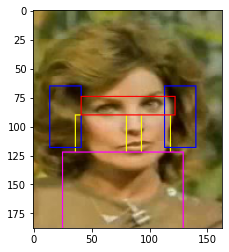

left cheek shape: (34, 44, 3)
y범위: 88~122
x범위: 36~80
left ear shape: (50, 26, 3)
y범위: 66~116
x범위: 14~40
right cheek shape: (34, 26, 3)
y범위: 88~122
x범위: 93~119
right ear shape: (50, 26, 3)
y범위: 66~116
x범위: 115~141
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 41~123
neck shape: (66, 105, 3)
y범위: 88~122
x범위: 25~130


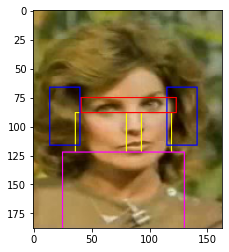

left cheek shape: (34, 44, 3)
y범위: 88~122
x범위: 37~81
left ear shape: (51, 26, 3)
y범위: 66~117
x범위: 15~41
right cheek shape: (34, 26, 3)
y범위: 88~122
x범위: 94~120
right ear shape: (51, 26, 3)
y범위: 66~117
x범위: 116~142
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 42~124
neck shape: (66, 105, 3)
y범위: 88~122
x범위: 26~131


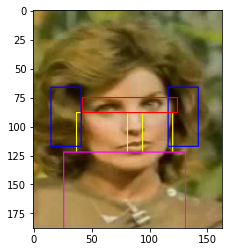

left cheek shape: (34, 45, 3)
y범위: 88~122
x범위: 36~81
left ear shape: (50, 26, 3)
y범위: 66~116
x범위: 14~40
right cheek shape: (34, 25, 3)
y범위: 88~122
x범위: 95~120
right ear shape: (50, 26, 3)
y범위: 66~116
x범위: 116~142
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 42~124
neck shape: (66, 106, 3)
y범위: 88~122
x범위: 25~131


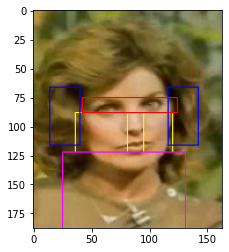

left cheek shape: (31, 44, 3)
y범위: 91~122
x범위: 36~80
left ear shape: (52, 27, 3)
y범위: 65~117
x범위: 14~41
right cheek shape: (31, 26, 3)
y범위: 91~122
x범위: 94~120
right ear shape: (52, 27, 3)
y범위: 65~117
x범위: 115~142
eye shape: (17, 82, 3)
y범위: 74~91
x범위: 42~124
neck shape: (66, 106, 3)
y범위: 91~122
x범위: 25~131


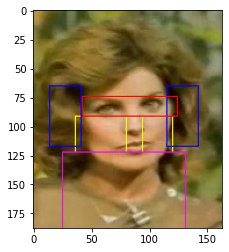

left cheek shape: (34, 43, 3)
y범위: 88~122
x범위: 37~80
left ear shape: (51, 25, 3)
y범위: 65~116
x범위: 16~41
right cheek shape: (34, 25, 3)
y범위: 88~122
x범위: 94~119
right ear shape: (51, 25, 3)
y범위: 65~116
x범위: 115~140
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 88~122
x범위: 27~129


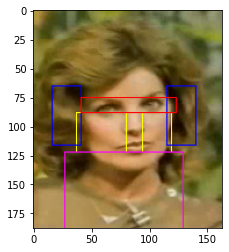

left cheek shape: (34, 44, 3)
y범위: 88~122
x범위: 36~80
left ear shape: (50, 26, 3)
y범위: 66~116
x범위: 14~40
right cheek shape: (34, 26, 3)
y범위: 88~122
x범위: 94~120
right ear shape: (50, 26, 3)
y범위: 66~116
x범위: 116~142
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 41~123
neck shape: (66, 106, 3)
y범위: 88~122
x범위: 25~131


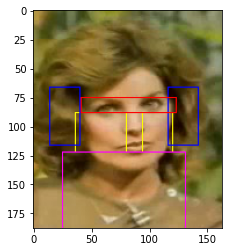

left cheek shape: (34, 43, 3)
y범위: 88~122
x범위: 37~80
left ear shape: (51, 25, 3)
y범위: 65~116
x범위: 16~41
right cheek shape: (34, 25, 3)
y범위: 88~122
x범위: 94~119
right ear shape: (51, 25, 3)
y범위: 65~116
x범위: 115~140
eye shape: (13, 82, 3)
y범위: 75~88
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 88~122
x범위: 27~129


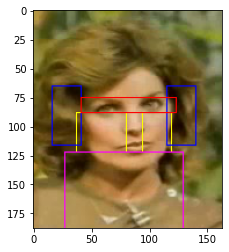

left cheek shape: (31, 43, 3)
y범위: 91~122
x범위: 37~80
left ear shape: (51, 26, 3)
y범위: 66~117
x범위: 16~42
right cheek shape: (31, 26, 3)
y범위: 91~122
x범위: 93~119
right ear shape: (51, 26, 3)
y범위: 66~117
x범위: 114~140
eye shape: (17, 82, 3)
y범위: 74~91
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 91~122
x범위: 27~129


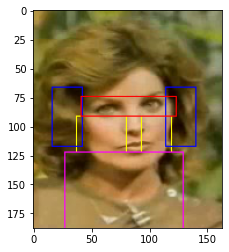

left cheek shape: (33, 43, 3)
y범위: 89~122
x범위: 37~80
left ear shape: (49, 25, 3)
y범위: 67~116
x범위: 16~41
right cheek shape: (33, 26, 3)
y범위: 89~122
x범위: 93~119
right ear shape: (49, 25, 3)
y범위: 67~116
x범위: 115~140
eye shape: (14, 82, 3)
y범위: 75~89
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 89~122
x범위: 27~129


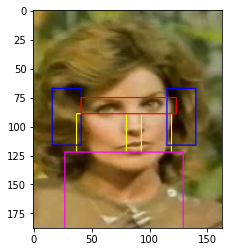

left cheek shape: (31, 43, 3)
y범위: 91~122
x범위: 37~80
left ear shape: (53, 27, 3)
y범위: 65~118
x범위: 16~43
right cheek shape: (31, 26, 3)
y범위: 91~122
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 65~118
x범위: 113~140
eye shape: (18, 82, 3)
y범위: 73~91
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 91~122
x범위: 27~129


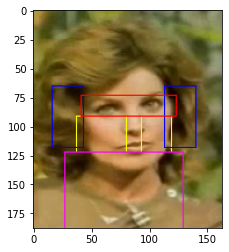

left cheek shape: (33, 43, 3)
y범위: 89~122
x범위: 37~80
left ear shape: (49, 25, 3)
y범위: 67~116
x범위: 16~41
right cheek shape: (33, 26, 3)
y범위: 89~122
x범위: 93~119
right ear shape: (49, 25, 3)
y범위: 67~116
x범위: 115~140
eye shape: (14, 81, 3)
y범위: 75~89
x범위: 42~123
neck shape: (66, 102, 3)
y범위: 89~122
x범위: 27~129


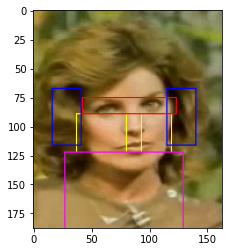

left cheek shape: (31, 45, 3)
y범위: 91~122
x범위: 36~81
left ear shape: (52, 27, 3)
y범위: 66~118
x범위: 14~41
right cheek shape: (31, 26, 3)
y범위: 91~122
x범위: 93~119
right ear shape: (52, 27, 3)
y범위: 66~118
x범위: 114~141
eye shape: (16, 82, 3)
y범위: 75~91
x범위: 42~124
neck shape: (66, 105, 3)
y범위: 91~122
x범위: 25~130


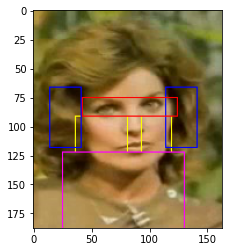

left cheek shape: (33, 45, 3)
y범위: 89~122
x범위: 35~80
left ear shape: (52, 26, 3)
y범위: 66~118
x범위: 13~39
right cheek shape: (33, 26, 3)
y범위: 89~122
x범위: 93~119
right ear shape: (52, 26, 3)
y범위: 66~118
x범위: 115~141
eye shape: (13, 82, 3)
y범위: 76~89
x범위: 42~124
neck shape: (66, 106, 3)
y범위: 89~122
x범위: 24~130


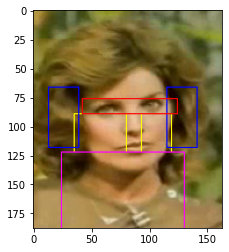

left cheek shape: (30, 45, 3)
y범위: 92~122
x범위: 35~80
left ear shape: (55, 28, 3)
y범위: 64~119
x범위: 13~41
right cheek shape: (30, 26, 3)
y범위: 92~122
x범위: 93~119
right ear shape: (55, 28, 3)
y범위: 64~119
x범위: 113~141
eye shape: (19, 82, 3)
y범위: 73~92
x범위: 41~123
neck shape: (66, 106, 3)
y범위: 92~122
x범위: 24~130


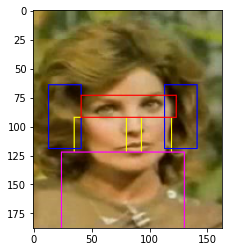

left cheek shape: (32, 44, 3)
y범위: 91~123
x범위: 36~80
left ear shape: (53, 27, 3)
y범위: 66~119
x범위: 14~41
right cheek shape: (32, 26, 3)
y범위: 91~123
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 66~119
x범위: 114~141
eye shape: (17, 82, 3)
y범위: 74~91
x범위: 41~123
neck shape: (65, 105, 3)
y범위: 91~123
x범위: 25~130


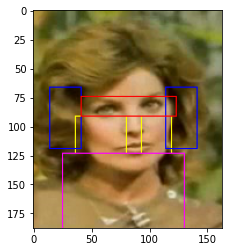

left cheek shape: (33, 43, 3)
y범위: 91~124
x범위: 37~80
left ear shape: (53, 26, 3)
y범위: 66~119
x범위: 16~42
right cheek shape: (33, 25, 3)
y범위: 91~124
x범위: 94~119
right ear shape: (53, 26, 3)
y범위: 66~119
x범위: 114~140
eye shape: (17, 82, 3)
y범위: 74~91
x범위: 41~123
neck shape: (64, 102, 3)
y범위: 91~124
x범위: 27~129


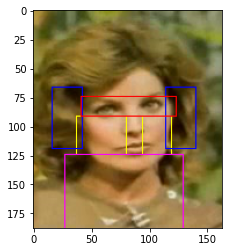

left cheek shape: (33, 43, 3)
y범위: 91~124
x범위: 36~79
left ear shape: (53, 26, 3)
y범위: 66~119
x범위: 15~41
right cheek shape: (33, 27, 3)
y범위: 91~124
x범위: 92~119
right ear shape: (53, 26, 3)
y범위: 66~119
x범위: 114~140
eye shape: (15, 85, 3)
y범위: 76~91
x범위: 39~124
neck shape: (64, 103, 3)
y범위: 91~124
x범위: 26~129


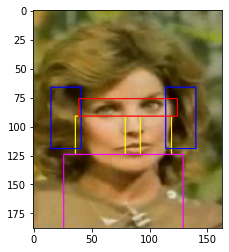

left cheek shape: (30, 43, 3)
y범위: 92~122
x범위: 37~80
left ear shape: (54, 27, 3)
y범위: 65~119
x범위: 16~43
right cheek shape: (30, 25, 3)
y범위: 92~122
x범위: 94~119
right ear shape: (54, 27, 3)
y범위: 65~119
x범위: 113~140
eye shape: (19, 82, 3)
y범위: 73~92
x범위: 41~123
neck shape: (66, 102, 3)
y범위: 92~122
x범위: 27~129


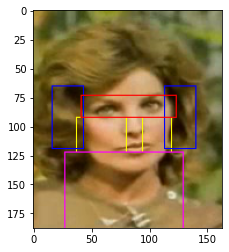

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (53, 27, 3)
y범위: 66~119
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 66~119
x범위: 114~141
eye shape: (16, 82, 3)
y범위: 75~91
x범위: 41~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


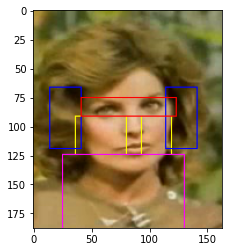

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (53, 27, 3)
y범위: 66~119
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 66~119
x범위: 114~141
eye shape: (16, 82, 3)
y범위: 75~91
x범위: 41~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


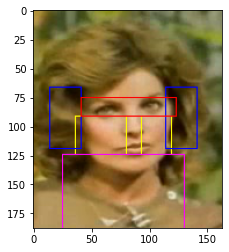

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (53, 27, 3)
y범위: 66~119
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 66~119
x범위: 114~141
eye shape: (15, 82, 3)
y범위: 76~91
x범위: 41~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


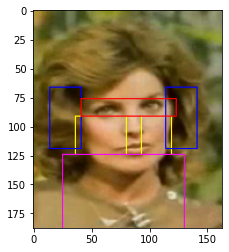

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 114~141
eye shape: (15, 82, 3)
y범위: 76~91
x범위: 41~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


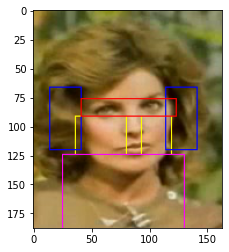

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (51, 27, 3)
y범위: 68~119
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (51, 27, 3)
y범위: 68~119
x범위: 114~141
eye shape: (15, 82, 3)
y범위: 76~91
x범위: 41~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


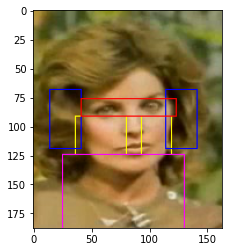

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 36~80
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 14~41
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 93~119
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 114~141
eye shape: (15, 81, 3)
y범위: 76~91
x범위: 42~123
neck shape: (64, 105, 3)
y범위: 91~124
x범위: 25~130


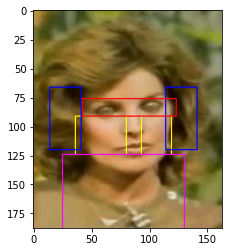

left cheek shape: (31, 44, 3)
y범위: 92~123
x범위: 36~80
left ear shape: (55, 28, 3)
y범위: 66~121
x범위: 14~42
right cheek shape: (31, 26, 3)
y범위: 92~123
x범위: 93~119
right ear shape: (55, 28, 3)
y범위: 66~121
x범위: 113~141
eye shape: (17, 82, 3)
y범위: 75~92
x범위: 41~123
neck shape: (65, 105, 3)
y범위: 92~123
x범위: 25~130


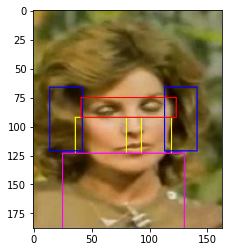

left cheek shape: (30, 42, 3)
y범위: 93~123
x범위: 37~79
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 16~43
right cheek shape: (30, 27, 3)
y범위: 93~123
x범위: 93~120
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 114~141
eye shape: (17, 81, 3)
y범위: 76~93
x범위: 41~122
neck shape: (65, 103, 3)
y범위: 93~123
x범위: 27~130


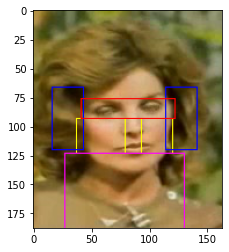

left cheek shape: (30, 45, 3)
y범위: 93~123
x범위: 35~80
left ear shape: (55, 28, 3)
y범위: 65~120
x범위: 13~41
right cheek shape: (30, 27, 3)
y범위: 93~123
x범위: 93~120
right ear shape: (55, 28, 3)
y범위: 65~120
x범위: 114~142
eye shape: (19, 81, 3)
y범위: 74~93
x범위: 41~122
neck shape: (65, 107, 3)
y범위: 93~123
x범위: 24~131


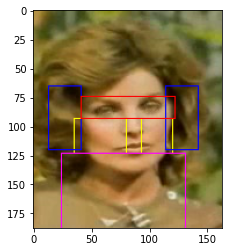

left cheek shape: (31, 44, 3)
y범위: 93~124
x범위: 36~80
left ear shape: (54, 28, 3)
y범위: 65~119
x범위: 14~42
right cheek shape: (31, 25, 3)
y범위: 93~124
x범위: 93~118
right ear shape: (54, 28, 3)
y범위: 65~119
x범위: 112~140
eye shape: (19, 81, 3)
y범위: 74~93
x범위: 41~122
neck shape: (64, 104, 3)
y범위: 93~124
x범위: 25~129


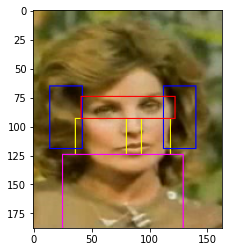

left cheek shape: (31, 44, 3)
y범위: 93~124
x범위: 36~80
left ear shape: (54, 28, 3)
y범위: 67~121
x범위: 14~42
right cheek shape: (31, 26, 3)
y범위: 93~124
x범위: 93~119
right ear shape: (54, 28, 3)
y범위: 67~121
x범위: 113~141
eye shape: (17, 81, 3)
y범위: 76~93
x범위: 41~122
neck shape: (64, 105, 3)
y범위: 93~124
x범위: 25~130


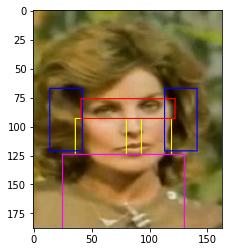

left cheek shape: (32, 44, 3)
y범위: 91~123
x범위: 35~79
left ear shape: (53, 27, 3)
y범위: 66~119
x범위: 13~40
right cheek shape: (32, 26, 3)
y범위: 91~123
x범위: 93~119
right ear shape: (53, 27, 3)
y범위: 66~119
x범위: 114~141
eye shape: (16, 81, 3)
y범위: 75~91
x범위: 41~122
neck shape: (65, 106, 3)
y범위: 91~123
x범위: 24~130


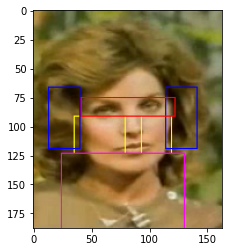

left cheek shape: (30, 43, 3)
y범위: 93~123
x범위: 35~78
left ear shape: (55, 27, 3)
y범위: 65~120
x범위: 14~41
right cheek shape: (30, 27, 3)
y범위: 93~123
x범위: 91~118
right ear shape: (55, 27, 3)
y범위: 65~120
x범위: 112~139
eye shape: (19, 82, 3)
y범위: 74~93
x범위: 39~121
neck shape: (65, 103, 3)
y범위: 93~123
x범위: 25~128


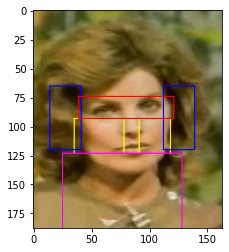

left cheek shape: (34, 43, 3)
y범위: 90~124
x범위: 35~78
left ear shape: (51, 25, 3)
y범위: 68~119
x범위: 14~39
right cheek shape: (34, 25, 3)
y범위: 90~124
x범위: 93~118
right ear shape: (51, 25, 3)
y범위: 68~119
x범위: 114~139
eye shape: (13, 81, 3)
y범위: 77~90
x범위: 40~121
neck shape: (64, 103, 3)
y범위: 90~124
x범위: 25~128


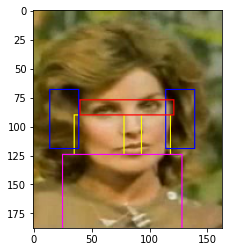

left cheek shape: (30, 44, 3)
y범위: 93~123
x범위: 35~79
left ear shape: (54, 28, 3)
y범위: 66~120
x범위: 13~41
right cheek shape: (30, 27, 3)
y범위: 93~123
x범위: 92~119
right ear shape: (54, 28, 3)
y범위: 66~120
x범위: 113~141
eye shape: (19, 82, 3)
y범위: 74~93
x범위: 40~122
neck shape: (65, 106, 3)
y범위: 93~123
x범위: 24~130


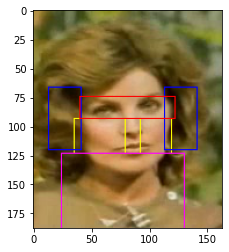

left cheek shape: (34, 43, 3)
y범위: 90~124
x범위: 34~77
left ear shape: (51, 25, 3)
y범위: 68~119
x범위: 13~38
right cheek shape: (34, 26, 3)
y범위: 90~124
x범위: 92~118
right ear shape: (51, 25, 3)
y범위: 68~119
x범위: 114~139
eye shape: (13, 82, 3)
y범위: 77~90
x범위: 40~122
neck shape: (64, 104, 3)
y범위: 90~124
x범위: 24~128


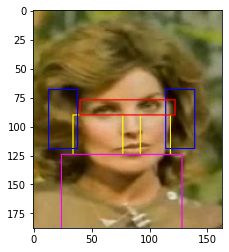

left cheek shape: (31, 44, 3)
y범위: 93~124
x범위: 34~78
left ear shape: (56, 28, 3)
y범위: 65~121
x범위: 12~40
right cheek shape: (31, 26, 3)
y범위: 93~124
x범위: 92~118
right ear shape: (56, 28, 3)
y범위: 65~121
x범위: 112~140
eye shape: (18, 85, 3)
y범위: 75~93
x범위: 38~123
neck shape: (64, 106, 3)
y범위: 93~124
x범위: 23~129


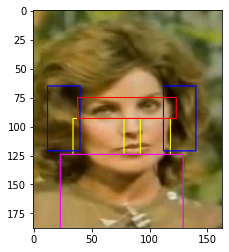

left cheek shape: (31, 44, 3)
y범위: 93~124
x범위: 34~78
left ear shape: (54, 28, 3)
y범위: 66~120
x범위: 12~40
right cheek shape: (31, 26, 3)
y범위: 93~124
x범위: 92~118
right ear shape: (54, 28, 3)
y범위: 66~120
x범위: 112~140
eye shape: (18, 85, 3)
y범위: 75~93
x범위: 38~123
neck shape: (64, 106, 3)
y범위: 93~124
x범위: 23~129


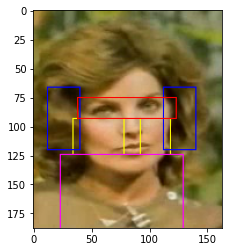

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 34~78
left ear shape: (52, 27, 3)
y범위: 68~120
x범위: 12~39
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 92~118
right ear shape: (52, 27, 3)
y범위: 68~120
x범위: 113~140
eye shape: (15, 85, 3)
y범위: 76~91
x범위: 38~123
neck shape: (64, 106, 3)
y범위: 91~124
x범위: 23~129


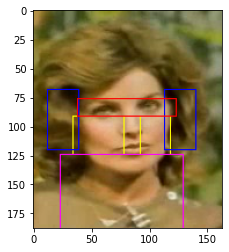

left cheek shape: (34, 45, 3)
y범위: 90~124
x범위: 34~79
left ear shape: (52, 26, 3)
y범위: 67~119
x범위: 12~38
right cheek shape: (34, 26, 3)
y범위: 90~124
x범위: 92~118
right ear shape: (52, 26, 3)
y범위: 67~119
x범위: 114~140
eye shape: (13, 82, 3)
y범위: 77~90
x범위: 40~122
neck shape: (64, 106, 3)
y범위: 90~124
x범위: 23~129


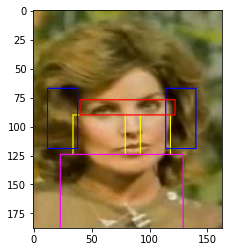

left cheek shape: (33, 44, 3)
y범위: 91~124
x범위: 34~78
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 12~39
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 92~118
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 113~140
eye shape: (16, 85, 3)
y범위: 75~91
x범위: 38~123
neck shape: (64, 106, 3)
y범위: 91~124
x범위: 23~129


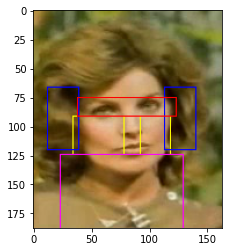

left cheek shape: (33, 43, 3)
y범위: 91~124
x범위: 35~78
left ear shape: (54, 26, 3)
y범위: 66~120
x범위: 14~40
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 92~118
right ear shape: (54, 26, 3)
y범위: 66~120
x범위: 113~139
eye shape: (15, 85, 3)
y범위: 76~91
x범위: 38~123
neck shape: (64, 103, 3)
y범위: 91~124
x범위: 25~128


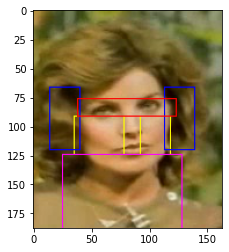

left cheek shape: (33, 43, 3)
y범위: 91~124
x범위: 35~78
left ear shape: (54, 26, 3)
y범위: 66~120
x범위: 14~40
right cheek shape: (33, 26, 3)
y범위: 91~124
x범위: 92~118
right ear shape: (54, 26, 3)
y범위: 66~120
x범위: 113~139
eye shape: (15, 85, 3)
y범위: 76~91
x범위: 38~123
neck shape: (64, 103, 3)
y범위: 91~124
x범위: 25~128


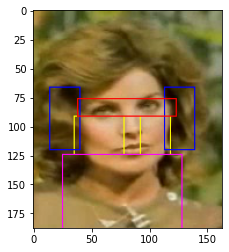

left cheek shape: (33, 44, 3)
y범위: 92~125
x범위: 34~78
left ear shape: (53, 27, 3)
y범위: 67~120
x범위: 12~39
right cheek shape: (33, 26, 3)
y범위: 92~125
x범위: 92~118
right ear shape: (53, 27, 3)
y범위: 67~120
x범위: 113~140
eye shape: (16, 82, 3)
y범위: 76~92
x범위: 39~121
neck shape: (63, 106, 3)
y범위: 92~125
x범위: 23~129


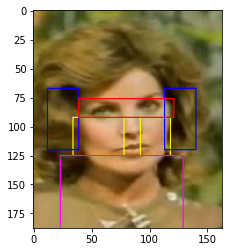

left cheek shape: (31, 44, 3)
y범위: 94~125
x범위: 34~78
left ear shape: (55, 28, 3)
y범위: 66~121
x범위: 12~40
right cheek shape: (31, 26, 3)
y범위: 94~125
x범위: 92~118
right ear shape: (55, 28, 3)
y범위: 66~121
x범위: 112~140
eye shape: (19, 85, 3)
y범위: 75~94
x범위: 38~123
neck shape: (63, 106, 3)
y범위: 94~125
x범위: 23~129


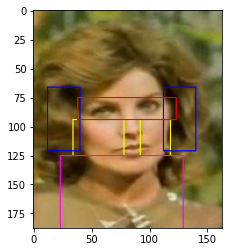

left cheek shape: (32, 44, 3)
y범위: 92~124
x범위: 34~78
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 12~39
right cheek shape: (32, 26, 3)
y범위: 92~124
x범위: 91~117
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 112~139
eye shape: (17, 85, 3)
y범위: 75~92
x범위: 37~122
neck shape: (64, 105, 3)
y범위: 92~124
x범위: 23~128


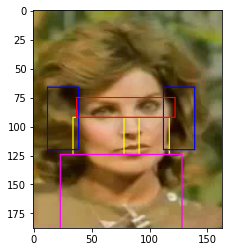

left cheek shape: (31, 44, 3)
y범위: 94~125
x범위: 34~78
left ear shape: (57, 28, 3)
y범위: 64~121
x범위: 12~40
right cheek shape: (31, 25, 3)
y범위: 94~125
x범위: 92~117
right ear shape: (57, 28, 3)
y범위: 64~121
x범위: 111~139
eye shape: (19, 82, 3)
y범위: 75~94
x범위: 39~121
neck shape: (63, 105, 3)
y범위: 94~125
x범위: 23~128


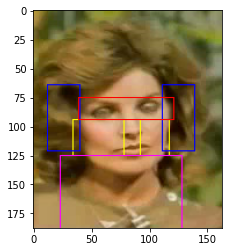

left cheek shape: (30, 43, 3)
y범위: 94~124
x범위: 35~78
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 14~41
right cheek shape: (30, 26, 3)
y범위: 94~124
x범위: 92~118
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 112~139
eye shape: (19, 81, 3)
y범위: 75~94
x범위: 39~120
neck shape: (64, 103, 3)
y범위: 94~124
x범위: 25~128


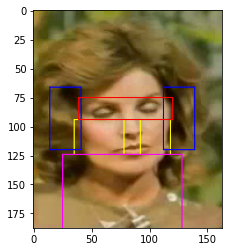

left cheek shape: (33, 44, 3)
y범위: 92~125
x범위: 34~78
left ear shape: (52, 27, 3)
y범위: 67~119
x범위: 12~39
right cheek shape: (33, 26, 3)
y범위: 92~125
x범위: 92~118
right ear shape: (52, 27, 3)
y범위: 67~119
x범위: 113~140
eye shape: (16, 81, 3)
y범위: 76~92
x범위: 39~120
neck shape: (63, 106, 3)
y범위: 92~125
x범위: 23~129


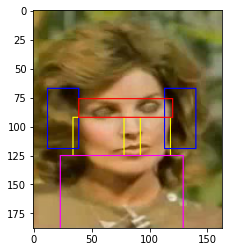

left cheek shape: (32, 45, 3)
y범위: 92~124
x범위: 34~79
left ear shape: (54, 27, 3)
y범위: 66~120
x범위: 12~39
right cheek shape: (32, 26, 3)
y범위: 92~124
x범위: 92~118
right ear shape: (54, 27, 3)
y범위: 66~120
x범위: 113~140
eye shape: (15, 85, 3)
y범위: 77~92
x범위: 38~123
neck shape: (64, 106, 3)
y범위: 92~124
x범위: 23~129


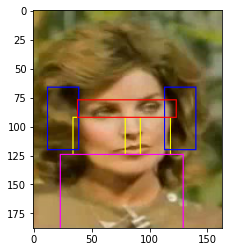

left cheek shape: (35, 43, 3)
y범위: 91~126
x범위: 34~77
left ear shape: (52, 25, 3)
y범위: 67~119
x범위: 13~38
right cheek shape: (35, 26, 3)
y범위: 91~126
x범위: 92~118
right ear shape: (52, 25, 3)
y범위: 67~119
x범위: 114~139
eye shape: (13, 82, 3)
y범위: 78~91
x범위: 38~120
neck shape: (62, 104, 3)
y범위: 91~126
x범위: 24~128


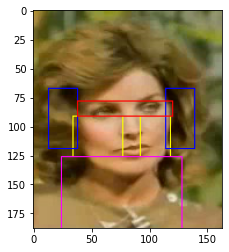

left cheek shape: (33, 45, 3)
y범위: 93~126
x범위: 34~79
left ear shape: (54, 27, 3)
y범위: 67~121
x범위: 12~39
right cheek shape: (33, 27, 3)
y범위: 93~126
x범위: 92~119
right ear shape: (54, 27, 3)
y범위: 67~121
x범위: 114~141
eye shape: (17, 85, 3)
y범위: 76~93
x범위: 37~122
neck shape: (62, 107, 3)
y범위: 93~126
x범위: 23~130


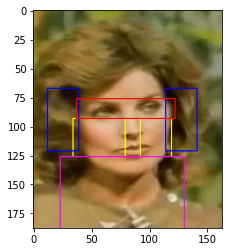

left cheek shape: (30, 45, 3)
y범위: 94~124
x범위: 34~79
left ear shape: (55, 28, 3)
y범위: 66~121
x범위: 12~40
right cheek shape: (30, 27, 3)
y범위: 94~124
x범위: 92~119
right ear shape: (55, 28, 3)
y범위: 66~121
x범위: 113~141
eye shape: (19, 86, 3)
y범위: 75~94
x범위: 37~123
neck shape: (64, 107, 3)
y범위: 94~124
x범위: 23~130


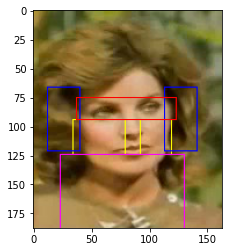

left cheek shape: (30, 45, 3)
y범위: 95~125
x범위: 33~78
left ear shape: (56, 28, 3)
y범위: 66~122
x범위: 11~39
right cheek shape: (30, 27, 3)
y범위: 95~125
x범위: 92~119
right ear shape: (56, 28, 3)
y범위: 66~122
x범위: 113~141
eye shape: (19, 85, 3)
y범위: 76~95
x범위: 37~122
neck shape: (63, 108, 3)
y범위: 95~125
x범위: 22~130


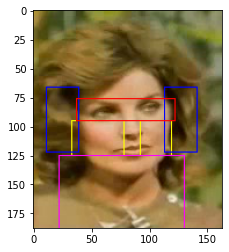

left cheek shape: (30, 46, 3)
y범위: 95~125
x범위: 33~79
left ear shape: (57, 29, 3)
y범위: 65~122
x범위: 10~39
right cheek shape: (30, 27, 3)
y범위: 95~125
x범위: 92~119
right ear shape: (57, 29, 3)
y범위: 65~122
x범위: 113~142
eye shape: (19, 85, 3)
y범위: 76~95
x범위: 37~122
neck shape: (63, 108, 3)
y범위: 95~125
x범위: 22~130


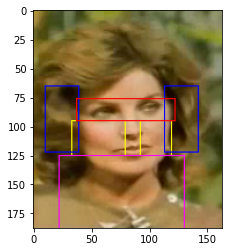

left cheek shape: (33, 45, 3)
y범위: 93~126
x범위: 34~79
left ear shape: (55, 27, 3)
y범위: 66~121
x범위: 12~39
right cheek shape: (33, 27, 3)
y범위: 93~126
x범위: 92~119
right ear shape: (55, 27, 3)
y범위: 66~121
x범위: 114~141
eye shape: (16, 82, 3)
y범위: 77~93
x범위: 40~122
neck shape: (62, 107, 3)
y범위: 93~126
x범위: 23~130


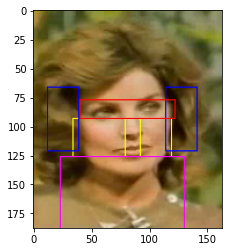

left cheek shape: (33, 43, 3)
y범위: 93~126
x범위: 34~77
left ear shape: (54, 26, 3)
y범위: 67~121
x범위: 13~39
right cheek shape: (33, 27, 3)
y범위: 93~126
x범위: 92~119
right ear shape: (54, 26, 3)
y범위: 67~121
x범위: 114~140
eye shape: (17, 86, 3)
y범위: 76~93
x범위: 37~123
neck shape: (62, 105, 3)
y범위: 93~126
x범위: 24~129


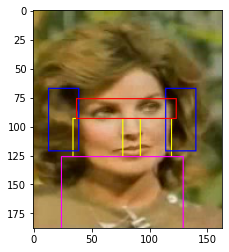

left cheek shape: (32, 46, 3)
y범위: 93~125
x범위: 33~79
left ear shape: (55, 28, 3)
y범위: 66~121
x범위: 10~38
right cheek shape: (32, 27, 3)
y범위: 93~125
x범위: 92~119
right ear shape: (55, 28, 3)
y범위: 66~121
x범위: 114~142
eye shape: (16, 82, 3)
y범위: 77~93
x범위: 40~122
neck shape: (63, 108, 3)
y범위: 93~125
x범위: 22~130


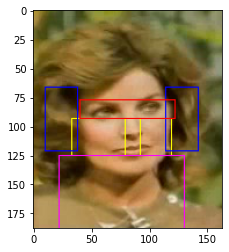

left cheek shape: (32, 46, 3)
y범위: 93~125
x범위: 33~79
left ear shape: (54, 28, 3)
y범위: 66~120
x범위: 10~38
right cheek shape: (32, 26, 3)
y범위: 93~125
x범위: 92~118
right ear shape: (54, 28, 3)
y범위: 66~120
x범위: 113~141
eye shape: (16, 85, 3)
y범위: 77~93
x범위: 38~123
neck shape: (63, 107, 3)
y범위: 93~125
x범위: 22~129


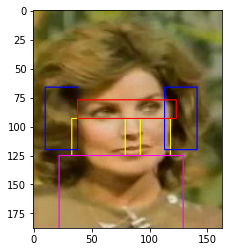

left cheek shape: (32, 43, 3)
y범위: 93~125
x범위: 34~77
left ear shape: (53, 26, 3)
y범위: 67~120
x범위: 13~39
right cheek shape: (32, 26, 3)
y범위: 93~125
x범위: 92~118
right ear shape: (53, 26, 3)
y범위: 67~120
x범위: 113~139
eye shape: (16, 86, 3)
y범위: 77~93
x범위: 37~123
neck shape: (63, 104, 3)
y범위: 93~125
x범위: 24~128


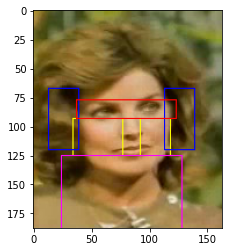

left cheek shape: (31, 46, 3)
y범위: 94~125
x범위: 33~79
left ear shape: (55, 29, 3)
y범위: 66~121
x범위: 10~39
right cheek shape: (31, 27, 3)
y범위: 94~125
x범위: 92~119
right ear shape: (55, 29, 3)
y범위: 66~121
x범위: 113~142
eye shape: (19, 85, 3)
y범위: 75~94
x범위: 38~123
neck shape: (63, 108, 3)
y범위: 94~125
x범위: 22~130


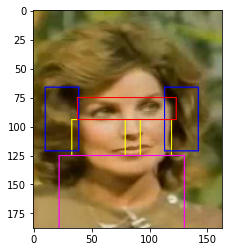

left cheek shape: (32, 42, 3)
y범위: 93~125
x범위: 35~77
left ear shape: (53, 26, 3)
y범위: 67~120
x범위: 14~40
right cheek shape: (32, 28, 3)
y범위: 93~125
x범위: 92~120
right ear shape: (53, 26, 3)
y범위: 67~120
x범위: 115~141
eye shape: (15, 85, 3)
y범위: 78~93
x범위: 38~123
neck shape: (63, 105, 3)
y범위: 93~125
x범위: 25~130


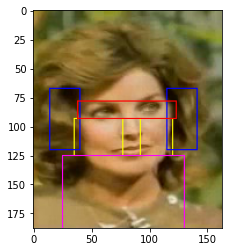

left cheek shape: (32, 42, 3)
y범위: 93~125
x범위: 35~77
left ear shape: (53, 26, 3)
y범위: 67~120
x범위: 14~40
right cheek shape: (32, 26, 3)
y범위: 93~125
x범위: 92~118
right ear shape: (53, 26, 3)
y범위: 67~120
x범위: 113~139
eye shape: (15, 85, 3)
y범위: 78~93
x범위: 38~123
neck shape: (63, 103, 3)
y범위: 93~125
x범위: 25~128


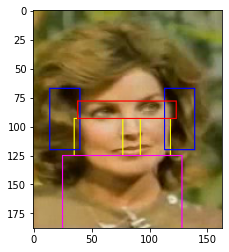

left cheek shape: (32, 42, 3)
y범위: 93~125
x범위: 35~77
left ear shape: (53, 26, 3)
y범위: 67~120
x범위: 14~40
right cheek shape: (32, 28, 3)
y범위: 93~125
x범위: 92~120
right ear shape: (53, 26, 3)
y범위: 67~120
x범위: 115~141
eye shape: (15, 86, 3)
y범위: 78~93
x범위: 37~123
neck shape: (63, 105, 3)
y범위: 93~125
x범위: 25~130


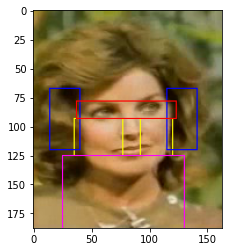

left cheek shape: (32, 44, 3)
y범위: 93~125
x범위: 33~77
left ear shape: (54, 27, 3)
y범위: 67~121
x범위: 11~38
right cheek shape: (32, 26, 3)
y범위: 93~125
x범위: 92~118
right ear shape: (54, 27, 3)
y범위: 67~121
x범위: 113~140
eye shape: (15, 86, 3)
y범위: 78~93
x범위: 37~123
neck shape: (63, 107, 3)
y범위: 93~125
x범위: 22~129


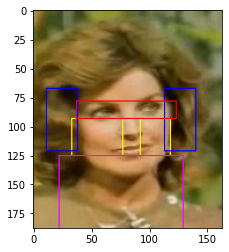

left cheek shape: (31, 44, 3)
y범위: 94~125
x범위: 33~77
left ear shape: (56, 28, 3)
y범위: 66~122
x범위: 11~39
right cheek shape: (31, 28, 3)
y범위: 94~125
x범위: 92~120
right ear shape: (56, 28, 3)
y범위: 66~122
x범위: 114~142
eye shape: (19, 86, 3)
y범위: 75~94
x범위: 37~123
neck shape: (63, 109, 3)
y범위: 94~125
x범위: 22~131


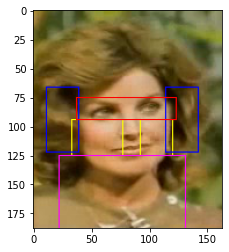

left cheek shape: (32, 44, 3)
y범위: 93~125
x범위: 33~77
left ear shape: (54, 27, 3)
y범위: 67~121
x범위: 11~38
right cheek shape: (32, 28, 3)
y범위: 93~125
x범위: 92~120
right ear shape: (54, 27, 3)
y범위: 67~121
x범위: 115~142
eye shape: (15, 86, 3)
y범위: 78~93
x범위: 37~123
neck shape: (63, 109, 3)
y범위: 93~125
x범위: 22~131


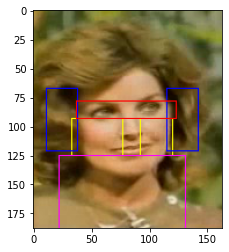

left cheek shape: (32, 44, 3)
y범위: 93~125
x범위: 33~77
left ear shape: (54, 27, 3)
y범위: 67~121
x범위: 11~38
right cheek shape: (32, 28, 3)
y범위: 93~125
x범위: 91~119
right ear shape: (54, 27, 3)
y범위: 67~121
x범위: 114~141
eye shape: (15, 85, 3)
y범위: 78~93
x범위: 36~121
neck shape: (63, 108, 3)
y범위: 93~125
x범위: 22~130


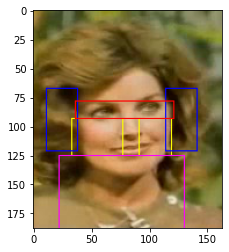

left cheek shape: (30, 46, 3)
y범위: 95~125
x범위: 31~77
left ear shape: (54, 29, 3)
y범위: 67~121
x범위: 8~37
right cheek shape: (30, 27, 3)
y범위: 95~125
x범위: 92~119
right ear shape: (54, 29, 3)
y범위: 67~121
x범위: 113~142
eye shape: (19, 87, 3)
y범위: 76~95
x범위: 36~123
neck shape: (63, 110, 3)
y범위: 95~125
x범위: 20~130


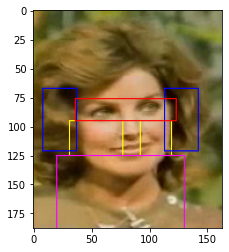

left cheek shape: (31, 46, 3)
y범위: 93~124
x범위: 31~77
left ear shape: (53, 28, 3)
y범위: 66~119
x범위: 8~36
right cheek shape: (31, 28, 3)
y범위: 93~124
x범위: 92~120
right ear shape: (53, 28, 3)
y범위: 66~119
x범위: 115~143
eye shape: (16, 86, 3)
y범위: 77~93
x범위: 37~123
neck shape: (64, 111, 3)
y범위: 93~124
x범위: 20~131


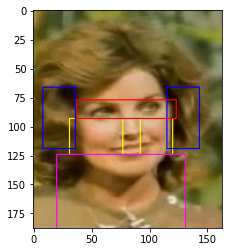

left cheek shape: (32, 46, 3)
y범위: 93~125
x범위: 31~77
left ear shape: (52, 28, 3)
y범위: 67~119
x범위: 8~36
right cheek shape: (32, 27, 3)
y범위: 93~125
x범위: 92~119
right ear shape: (52, 28, 3)
y범위: 67~119
x범위: 114~142
eye shape: (16, 87, 3)
y범위: 77~93
x범위: 36~123
neck shape: (63, 110, 3)
y범위: 93~125
x범위: 20~130


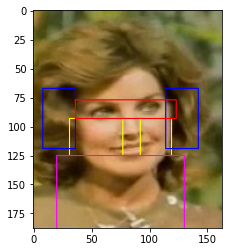

left cheek shape: (34, 46, 3)
y범위: 91~125
x범위: 30~76
left ear shape: (51, 27, 3)
y범위: 67~118
x범위: 7~34
right cheek shape: (34, 26, 3)
y범위: 91~125
x범위: 92~118
right ear shape: (51, 27, 3)
y범위: 67~118
x범위: 114~141
eye shape: (13, 82, 3)
y범위: 78~91
x범위: 38~120
neck shape: (63, 110, 3)
y범위: 91~125
x범위: 19~129


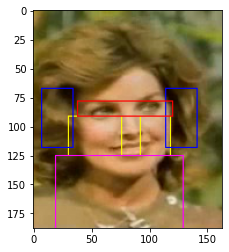

left cheek shape: (32, 45, 3)
y범위: 94~126
x범위: 31~76
left ear shape: (54, 28, 3)
y범위: 65~119
x범위: 9~37
right cheek shape: (32, 28, 3)
y범위: 94~126
x범위: 91~119
right ear shape: (54, 28, 3)
y범위: 65~119
x범위: 113~141
eye shape: (19, 85, 3)
y범위: 75~94
x범위: 37~122
neck shape: (62, 110, 3)
y범위: 94~126
x범위: 20~130


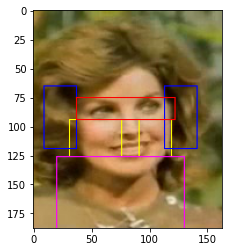

left cheek shape: (36, 47, 3)
y범위: 91~127
x범위: 29~76
left ear shape: (52, 28, 3)
y범위: 66~118
x범위: 6~34
right cheek shape: (36, 28, 3)
y범위: 91~127
x범위: 91~119
right ear shape: (52, 28, 3)
y범위: 66~118
x범위: 114~142
eye shape: (15, 86, 3)
y범위: 76~91
x범위: 36~122
neck shape: (61, 112, 3)
y범위: 91~127
x범위: 18~130


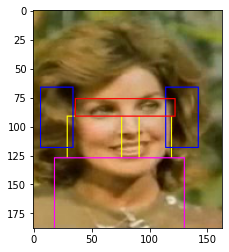

left cheek shape: (33, 45, 3)
y범위: 93~126
x범위: 31~76
left ear shape: (54, 28, 3)
y범위: 64~118
x범위: 9~37
right cheek shape: (33, 28, 3)
y범위: 93~126
x범위: 91~119
right ear shape: (54, 28, 3)
y범위: 64~118
x범위: 113~141
eye shape: (18, 85, 3)
y범위: 75~93
x범위: 37~122
neck shape: (62, 110, 3)
y범위: 93~126
x범위: 20~130


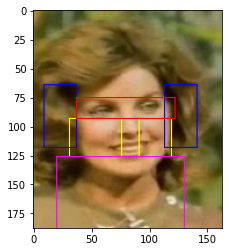

left cheek shape: (34, 43, 3)
y범위: 92~126
x범위: 30~73
left ear shape: (54, 27, 3)
y범위: 64~118
x범위: 9~36
right cheek shape: (34, 29, 3)
y범위: 92~126
x범위: 89~118
right ear shape: (54, 27, 3)
y범위: 64~118
x범위: 112~139
eye shape: (17, 86, 3)
y범위: 75~92
x범위: 34~120
neck shape: (62, 108, 3)
y범위: 92~126
x범위: 20~128


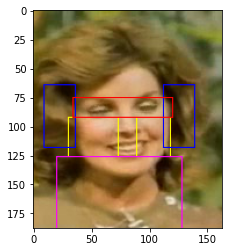

left cheek shape: (33, 43, 3)
y범위: 93~126
x범위: 29~72
left ear shape: (55, 28, 3)
y범위: 64~119
x범위: 8~36
right cheek shape: (33, 30, 3)
y범위: 93~126
x범위: 87~117
right ear shape: (55, 28, 3)
y범위: 64~119
x범위: 110~138
eye shape: (19, 87, 3)
y범위: 74~93
x범위: 32~119
neck shape: (62, 108, 3)
y범위: 93~126
x범위: 19~127


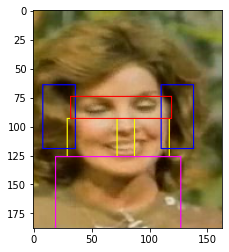

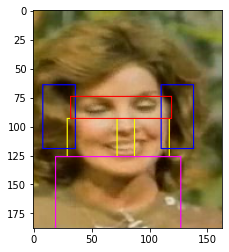

In [ ]:
# 수집한 데이터를 입력했을 때
vid = []
for i in range(colorImages.shape[3]):
  input_img = colorImages[:,:,:,i] 
  x,y = file2frame(input_img)
  frame = im_trim(input_img, x, y,i)
  vid.append(frame)
HTML(plot_images(np.array(vid)).to_html5_video())
# boxing 영상 출력

right cheek shape: (22, 35, 3)
y범위: 65~87
x범위: 47~82
right ear shape: (29, 20, 3)
y범위: 55~84
x범위: 79~99
eye shape: (9, 27, 3)
y범위: 56~65
x범위: 36~63
neck shape: (57, 58, 3)
y범위: 65~87
x범위: 32~90


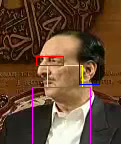

In [ ]:
# crop
# segmentation -> save

plt.rcParams["figure.figsize"] = (15,15)

def im_trim (img,x,y,idx):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)     # 이미지 색상 변환: openCV는 기본적으로 bgr로 구성

  # EYE
  x_extra_eye = (x[1]-x[0])//3                   # 양안 전체 길이의 1/3정도 여유를 두고 crop 
  
  if y[2]-y[0] < y[3]-y[1]:                      # 눈썹 양 끝 점을 기준으로 눈과의 간격이 더 긴 점을 찾고, 그 높이*1.5 만큼 crop
    y_diff_eye = (y[3]-y[1])//1.5
  else:
    y_diff_eye = (y[2]-y[0])//1.5
  
  if y[0] < y[1]:                                # 양안 중 높이가 더 낮은 것을 기준으로 y의 범위를 지정해줌
    y_start_eye = int(y[0]+y_diff_eye)
    y_end_eye = int(y[1]-y_diff_eye)
  else:
    y_start_eye = int(y[1]+y_diff_eye)
    y_end_eye = int(y[0]-y_diff_eye)
  
  # EAR
  '''
  if x[1]-x[4] > x[5]-x[3]:
    x_extra_ear = (x[1]-x[4])//3
  else:
    x_extra_ear = (x[5]-x[3])//3
  '''
  y_start_ear = int(y[3]+y_diff_eye)
  y_end_ear = int(y[6]-y_diff_eye)
  
  # NECK
  y_start_neck = int(y[7])

  # CHEEK: 기존에 연산해놓은 좌표 활용  

  # crop
  # ear, cheek는 x의 범위가 40이하일 경우 무시해줌
  
  ############################################################################## CHEEK & EAR
  if int(x[8]-x[4]) >= int(x[5]-x[9]):                                         # 양 볼의 x좌표 차이 중 그 차이가 큰 것을 cheek_diff에 저장
    cheek_diff = int(x[8]-x[4])                                                # max() 사용시 python 'numpy.int64' object is not callable error 발생 
  else:
    cheek_diff = int(x[5]-x[9])
  cheek_js = cheek_diff//2                                                     # cheek_diff//3 보다 그 넓이가 작을 경우: 측면에 해당하므로 cheek & ear 출력 및 저장 X
  if int(x[8])-int(x[4])>cheek_js:                                             
    img_trim_cheek_left = img[y_end_eye:int(y[7]), int(x[4]):int(x[8])]                               # cheek_left    
    print(f'\033[1mleft cheek shape\033[0m: {img_trim_cheek_left.shape}')
    print(f'y범위: {int(y_end_eye)}~{int(y[7])}')
    print(f'x범위: {int(x[4])}~{int(x[8])}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_cheek_left_{idx}.jpg',img_trim_cheek_left)
    cv2.rectangle(img, (int(x[4]), int(y_end_eye)), (int(x[8]),int(y[7])), (0,255,255), 1)               

    img_trim_ear_left = img[y_start_ear:y_end_ear, int(x[4]-cheek_js):int(x[4]-y_diff_eye)]         # ear_left         
    print(f'\033[1mleft ear shape\033[0m: {img_trim_ear_left.shape}')
    print(f'y범위: {int(y_start_ear)}~{int(y_end_ear)}')
    print(f'x범위: {int(x[4]-cheek_js)}~{int(x[4]-y_diff_eye)}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_ear_left_{idx}.jpg',img_trim_ear_left)
    cv2.rectangle(img, (int(x[4]-cheek_js), int(y_start_ear)), (int(x[4]-y_diff_eye),int(y_end_ear)), (255,0,0), 1)             

  if int(x[5])-int(x[9])>cheek_js:                                              
    img_trim_cheek_right = img[y_end_eye:int(y[7]), int(x[9]):int(x[5])]                               # cheek_right                           
    print(f'\033[1mright cheek shape\033[0m: {img_trim_cheek_right.shape}')
    print(f'y범위: {int(y_end_eye)}~{int(y[7])}')
    print(f'x범위: {int(x[9])}~{int(x[5])}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_cheek_right_{idx}.jpg',img_trim_cheek_right)
    cv2.rectangle(img, (int(x[9]), int(y_end_eye)), (int(x[5]),int(y[7])), (0,255,255), 1)                                        
    
    img_trim_ear_right = img[y_start_ear:y_end_ear, int(x[5]+y_diff_eye):int(x[5]+cheek_js)]         # ear_right
    print(f'\033[1mright ear shape\033[0m: {img_trim_ear_right.shape}')
    print(f'y범위: {int(y_start_ear)}~{int(y_end_ear)}')
    print(f'x범위: {int(x[5]+y_diff_eye)}~{int(x[5]+cheek_js)}')
    cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_ear_right_{idx}.jpg',img_trim_ear_right)
    cv2.rectangle(img, (int(x[5]+y_diff_eye), int(y_start_ear)), (int(x[5]+cheek_js),int(y_end_ear)), (255,0,0), 1)             

  ############################################################################## EYE
  img_trim_eye = img[y_start_eye:y_end_eye, int(x[0]-x_extra_eye):int(x[1]+x_extra_eye)]              
  
  ############################################################################## NECK
  img_trim_neck = img[y_start_neck:img.shape[0], int(x[4]-cheek_js//2):int(x[5]+cheek_js//2)]                                   # neck: neck_end를 귀의 x_end에 맞추자


  print(f'\033[1meye shape\033[0m: {img_trim_eye.shape}')
  print(f'y범위: {int(y_start_eye)}~{int(y_end_eye)}')
  print(f'x범위: {int(x[0]-x_extra_eye)}~{int(x[1]+x_extra_eye)}')

  print(f'\033[1mneck shape\033[0m: {img_trim_neck.shape}') 
  print(f'y범위: {int(y_end_eye)}~{y_start_neck}')
  print(f'x범위: {int(x[4]-cheek_js//2)}~{int(x[5]+cheek_js//2)}')
  
  #img_trim = cv2.resize(img_trim, dsize=(100,100)) # resize하면 해상도가 너무 떨어져서 논의 필요
  cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_eye_{idx}.jpg',img_trim_eye)   # eye의 y 수정할 필요있음 (수집된 이미지는 y의 방향이 역방향으로 나옴)
  cv2.imwrite(f'/content/drive/Shareddrives/BME캡스톤/code/KYJ/crop_test/Crop_neck_{idx}.jpg',img_trim_neck) 

  # crop될 이미지: bounding box 표시
  cv2.rectangle(img, (int(x[0]-x_extra_eye), int(y_start_eye)), (int(x[1]+x_extra_eye),int(y_end_eye)), (0,0,255), 1)            # eye
  cv2.rectangle(img, (int(x[4]-cheek_js//2), int(y_start_neck)), (int(x[5]+cheek_js//2),int(img.shape[0])), (255,0,255), 1)                              # neck

  cv2_imshow(img)

# input: array
# x(좌표) = [eye1_left, eye2_right, eyebrow1_left, eyebrow2_right, ear1_left, ear2_right, lip_high, lip_low, nostrill_left, nostrill_right]
# y(좌표) = [eye1_left, eye2_right, eyebrow1_left, eyebrow2_right, ear1_left, ear2_right, lip_high, lip_low, nostrill_left, nostrill_right]
im_trim(input_img, x, y,11)